In [5]:
#!/usr/bin/env Rscript 
library(dplyr)
library(Seurat)
library(httr)
library(readr)
library(pheatmap)
library(RColorBrewer)
library(ggplot2)
library(cowplot)
library(patchwork)
library(unixtools)
library(ggrepel)
library(repr)
library(ggmin)
library(harmony)
library(SeuratWrappers)
library(Nebulosa)
library(ggthemes)
set_config(config(ssl_verifypeer = 0L))
ulimit::memory_limit(100000)
set.tempdir("/datastore/lucy/tmp/")
setwd("/datastore/lucy/TREM2development")
options(warn = -1, verbose=FALSE)

Loading required package: Rcpp



ERROR: Error in library(Nebulosa): there is no package called ‘Nebulosa’


In [6]:
setwd("/datastore/lucy/TREM2development")


In [3]:
myeloid <- readRDS("myeloid_with.cycling.rds")

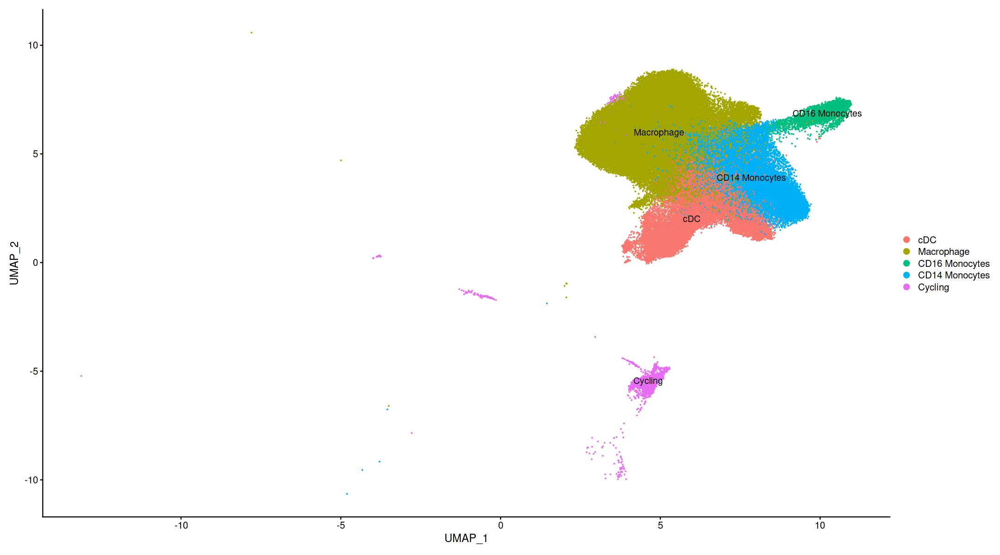

In [4]:
options(repr.plot.width=18, repr.plot.height=10)
DimPlot(myeloid, label=TRUE)

In [5]:
table(myeloid$celltype, myeloid$Tissue)

                   
                       PB    ST
  Sublining FLS         0     0
  Lining FLS            0     0
  Pericytes             0     0
  Endothelial cells     0     0
  CD4 T cells           0     0
  CD8 T cells           0     0
  NK cells              0     0
  B cells               0     0
  Plasma cells          0     0
  Mast cells            0     0
  pDC                   0     0
  cDC                1278 14870
  Macrophage          120 43171
  CD16 Monocytes     3399   429
  CD14 Monocytes    15454  5325
  Cycling             127  1568

# Continue with typical preprocessing pipeline

In [6]:
myeloid <- myeloid %>%
    NormalizeData() %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData() %>% RunPCA()

Centering and scaling data matrix

PC_ 1 
Positive:  C1QA, RNASE1, C1QB, C1QC, LMNA, LGMN, GPNMB, PLTP, FOLR2, VSIG4 
	   CTSL, MARCO, DAB2, FTL, A2M, EMP1, PMP22, NUPR1, CD81, CTSZ 
	   MSR1, HLA-DRB1, MS4A4A, LILRB5, HLA-DPB1, HSPB1, C2, IFI27, CFD, FN1 
Negative:  FCN1, CD48, RIPOR2, RAC2, LYST, LCP1, CD52, LIMD2, VSIR, VCAN 
	   LSP1, FGR, MNDA, ITGA4, MEGF9, SELL, ITGAL, POU2F2, CASP1, CPPED1 
	   CORO1A, CSF3R, SPN, CDC42EP3, MPEG1, S100A12, JAML, PRKCB, FYB1, LRRK2 
PC_ 2 
Positive:  MT-ND5, RHOB, MT-ND2, MT-ATP8, MT-ND1, FYB1, MT-ATP6, TXNIP, JUN, ADA2 
	   MT-ND4L, KLF4, SELENOP, ZFP36L1, ALDH1A1, KLF2, PECAM1, LILRB5, KLF6, MATR3 
	   SAMHD1, MPEG1, UCP2, ADAP2, CD84, COLEC12, CTSB, EGR1, DAB2, C2 
Negative:  RPS17, C15orf48, CREM, ALDOA, RPL17, TIMP1, MIF, GPR183, CXCR4, AREG 
	   EREG, FABP5, ISG20, CST7, DUSP4, MT2A, CRIP1, SAMSN1, CLEC10A, PHLDA1 
	   FCER1A, PLAUR, GPAT3, LGALS2, IFI30, LGALS1, SDS, C12orf75, CYTIP, IL1R2 
PC_ 3 
Positive:  MKI67, TOP2A, TYMS, CENPF, NUS

In [7]:
#Preintegration
myeloid <- RunUMAP(object = myeloid, reduction = "pca", dims = 1:40)

12:27:32 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:27:32 Read 85741 rows and found 40 numeric columns

12:27:32 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:27:32 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

12:27:44 Writing NN index file to temp file /datastore/lucy/tmp//file39fe247f4a8fb7

12:27:44 Searching Annoy index using 1 thread, search_k = 3000

12:28:22 Annoy recall = 100%

12:28:23 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

12:28:26 Initializing from normalized Lapla

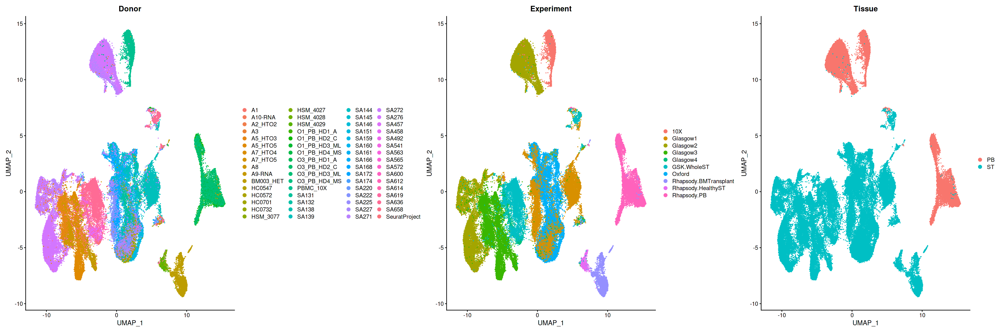

In [8]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue"))

# Harmonize

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony 7/10

Harmony 8/10

Harmony 9/10

Harmony 10/10



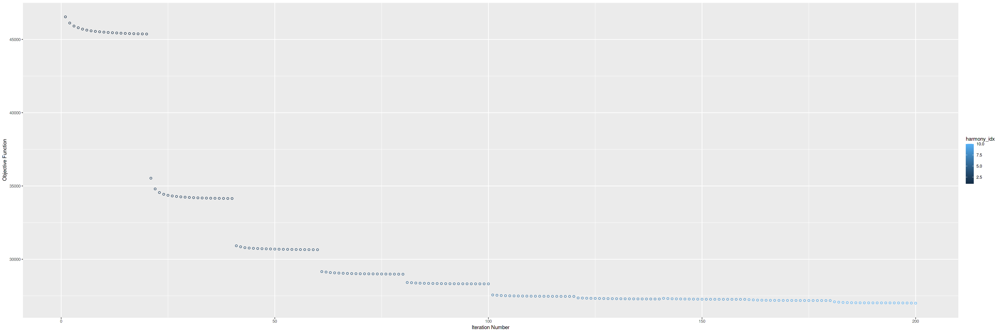

In [9]:
#Harmonize
myeloid <- myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,2))

In [10]:
#Run UMAP and clustering
myeloid <- RunUMAP(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=0.2)

13:03:53 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

13:03:53 Read 85741 rows and found 40 numeric columns

13:03:53 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

13:03:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:04:07 Writing NN index file to temp file /datastore/lucy/tmp//file39fe245a50ea61

13:04:07 Searching Annoy index using 1 thread, search_k = 3000

13:04:57 Annoy recall = 100%

13:04:59 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:05:03 Initializing from normalized Lapla

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 85741
Number of edges: 2554733

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9370
Number of communities: 17
Elapsed time: 70 seconds


6 singletons identified. 11 final clusters.



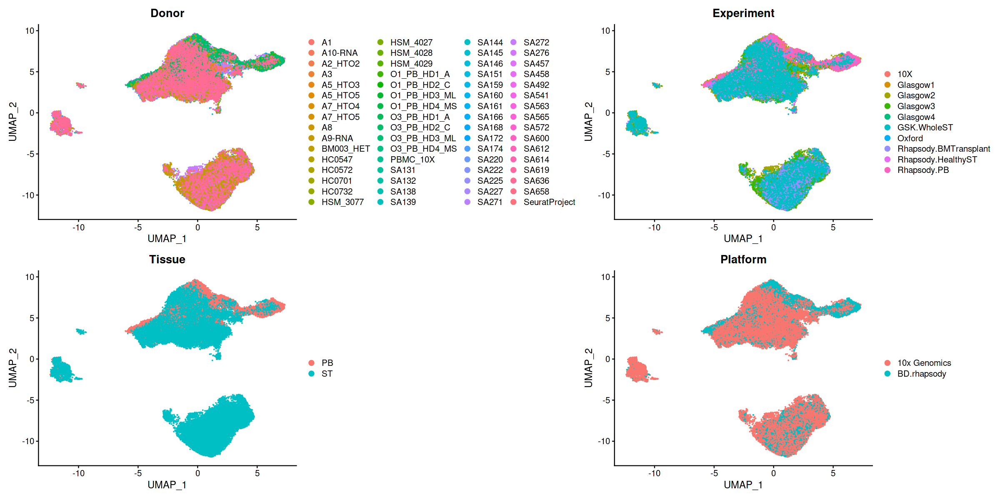

In [11]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue","Platform"))

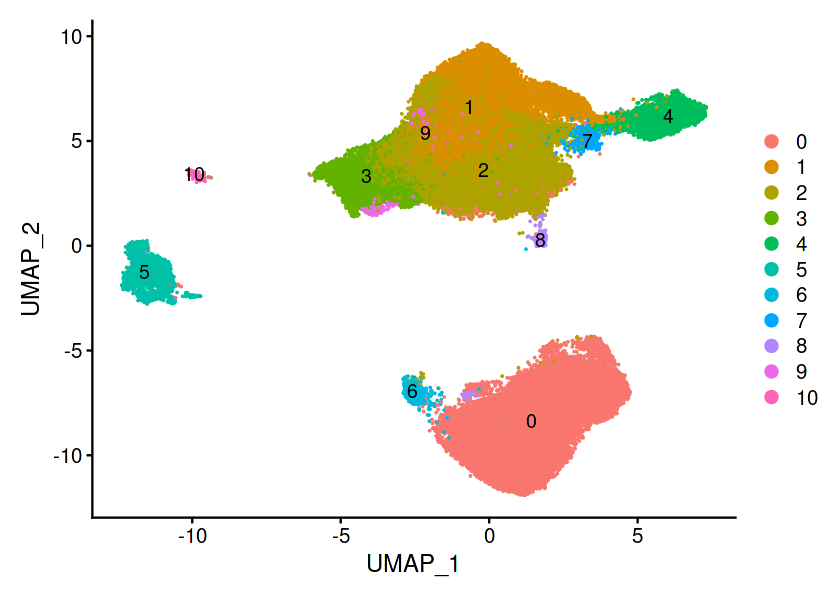

In [12]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

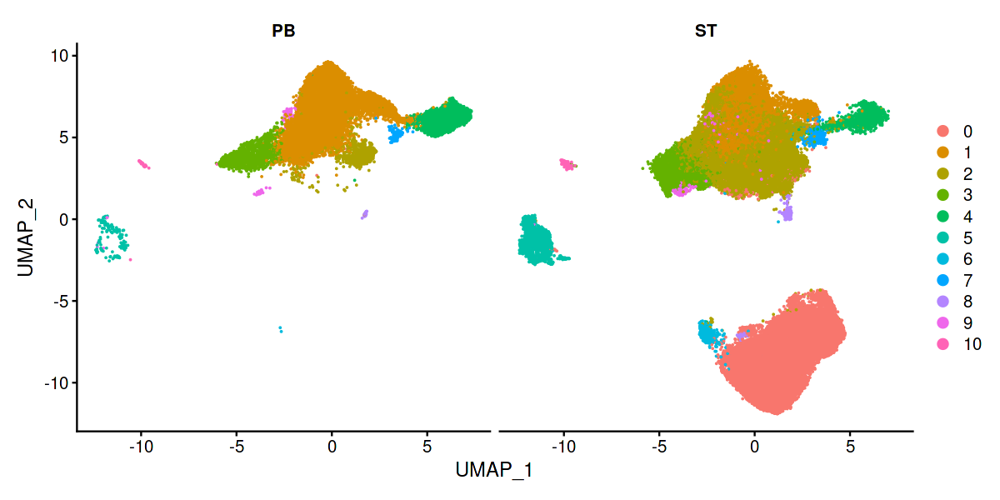

In [13]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, split.by="Tissue")

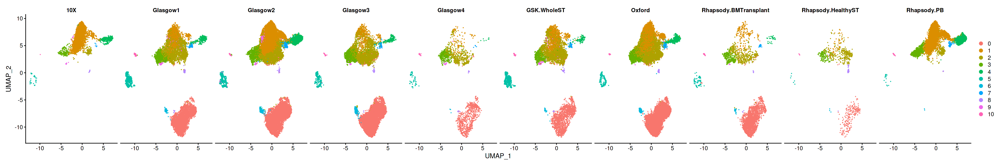

In [14]:
options(repr.plot.width=30, repr.plot.height=5)
DimPlot(myeloid, split.by="Experiment")

# Find cluster marker genes

In [15]:
cluster.markers <- FindAllMarkers(subset(myeloid, downsample = 500), only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [====


 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [===========================


 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [===========================


 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>------


 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>----------------


 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [===========================


 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------


 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 3


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Complet


 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [===========================


 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [===========================


 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>--


 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>--------------


 Completed [=========================================>--]  96% with 0 failures

 Completed [=========================================>--]  97% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 5


 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Complet


 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [===========================


 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================


 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>--------


 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>------------------


 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [=========================================>--]  97% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================


 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [===========================


 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [===========================


 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [===========================


 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-------


 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>--------------


 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!



In [33]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

In [35]:
top10[top10$cluster=="10",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.144382e-245,3.143831,0.589,0.020,1.833873e-241,10,S100B
3.815559e-294,2.798818,0.652,0.011,6.114433e-290,10,TACSTD2
8.072660e-289,2.558108,0.801,0.196,1.293644e-284,10,C1orf54
2.416695e-261,2.265334,0.864,0.603,3.872754e-257,10,CPVL
1.712124e-245,2.256142,0.758,0.223,2.743679e-241,10,CPNE3
2.064089e-86,2.176567,0.559,0.211,3.307703e-82,10,VMO1
6.436477e-178,2.114183,0.773,0.356,1.031445e-173,10,IRF8
7.080147e-116,2.051013,0.917,0.709,1.134594e-111,10,TXN
2.097541e-192,2.040810,0.582,0.029,3.361310e-188,10,IDO1


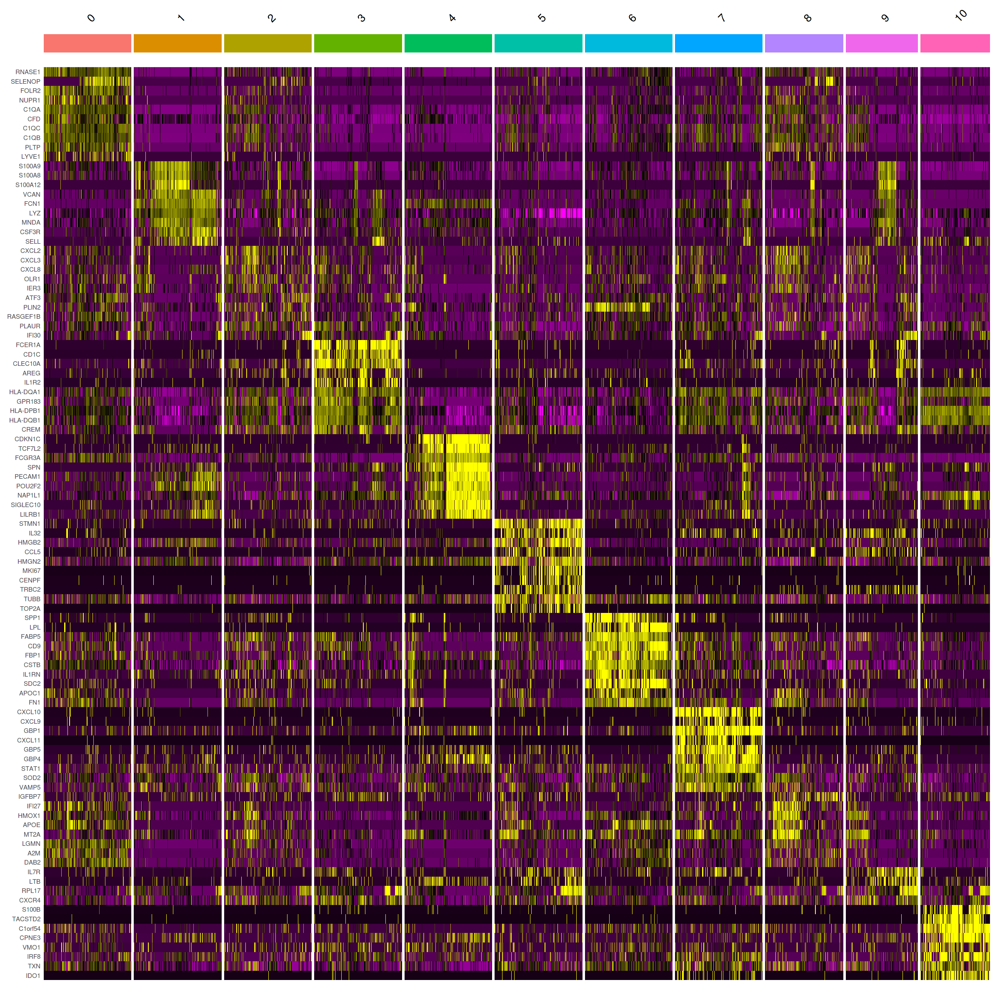

In [18]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(subset(myeloid, downsample = 500), features=unique(top10$gene)) + NoLegend()

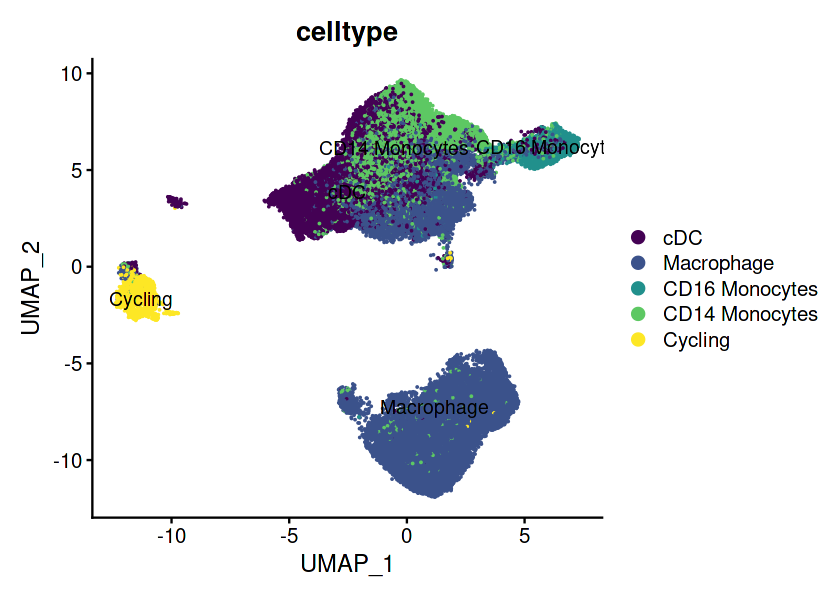

In [36]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE, group.by="celltype")

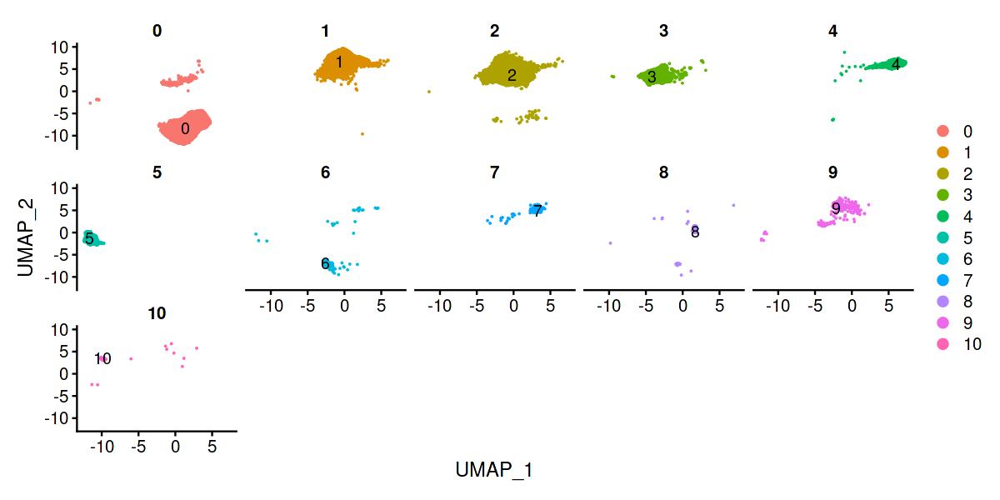

In [40]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, label=TRUE, split.by="seurat_clusters", ncol=5)

# Isolate cycling to ensure cycling macrophage only

In [41]:
cycling <- subset(myeloid, idents=5)

In [42]:
#Continue with typical preprocessing pipeline
cycling <- cycling %>%
    NormalizeData() %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData() %>% RunPCA()

Centering and scaling data matrix

PC_ 1 
Positive:  CST3, NPC2, PSAP, FTL, HLA-DRA, LYZ, CTSB, C1QA, GRN, CD68 
	   CTSS, CTSZ, CD14, MS4A6A, RNASE1, C1QB, GLUL, HLA-DRB1, C1QC, CD74 
	   FCGRT, CYBB, MARCO, CTSL, HLA-DPB1, TGFBI, MAFB, HLA-DPA1, FN1, VSIG4 
Negative:  C12orf75, GZMA, IL32, TRBC2, NKG7, CD3D, CD2, ETS1, CD3E, ITM2A 
	   PCLAF, SYNE2, TRAC, MKI67, CD247, IL2RG, DUSP4, LCK, TUBA4A, SH2D1A 
	   CD3G, SUB1, JPT1, GZMB, CCL5, HOPX, GZMH, SPOCK2, CST7, TYMS 
PC_ 2 
Positive:  SPARCL1, COL4A2, CAV1, COL4A1, TM4SF1, VWF, PLVAP, ADGRL4, GNG11, ECSCR 
	   HSPG2, COL15A1, PCAT19, MGP, EMCN, VWA1, POSTN, ARHGAP29, AQP1, RAMP2 
	   IGFBP7, ESAM, S100A16, CAV2, ADAMTS9, CD34, CDH5, CLEC14A, CAVIN1, SPARC 
Negative:  CST7, FTL, GPR183, MT1X, TYMP, CCL5, HLA-DPB1, NKG7, SAT1, TRBC2 
	   C15orf48, GZMA, CD3D, MT1F, CXCL8, HLA-DQA1, IL32, S100A9, BASP1, HLA-DQA2 
	   CD7, CD2, TRBC1, RGS1, HLA-DQB1, CXCL3, GZMM, TRAC, SDS, HLA-DRA 
PC_ 3 
Positive:  HMOX1, IFI27, MT2A, ALDOA, MT1X, MT1

In [43]:
#Preintegration
cycling <- RunUMAP(object = cycling, reduction = "pca", dims = 1:40)

13:50:00 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

13:50:00 Read 2361 rows and found 40 numeric columns

13:50:00 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

13:50:00 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:50:00 Writing NN index file to temp file /datastore/lucy/tmp//file39fe246558fad1

13:50:00 Searching Annoy index using 1 thread, search_k = 3000

13:50:01 Annoy recall = 100%

13:50:02 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:50:03 Initializing from normalized Laplac

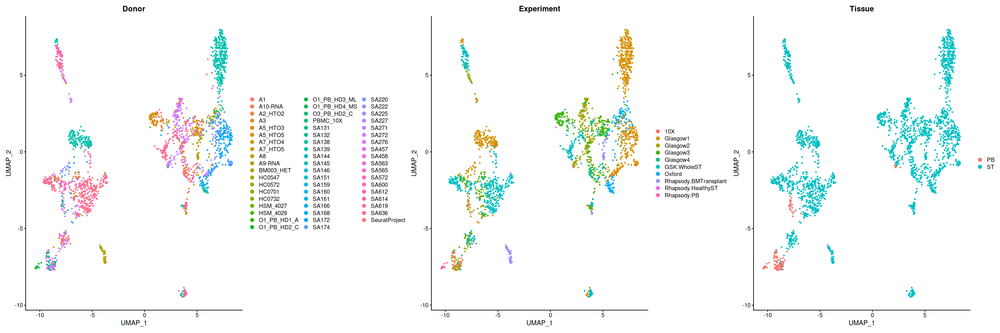

In [44]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(cycling, group.by=c("Donor","Experiment","Tissue"))

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony 7/10

Harmony 8/10

Harmony 9/10

Harmony 10/10



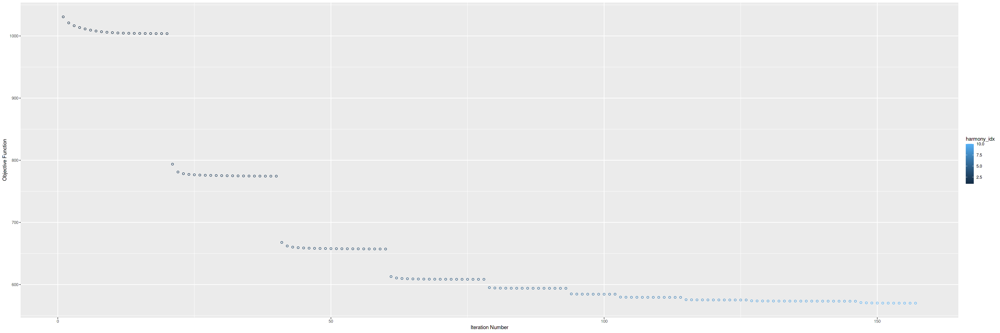

In [45]:
#Harmonize
cycling <- cycling %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,2))

In [46]:
#Run UMAP and clustering
cycling <- RunUMAP(object = cycling, reduction = "harmony", dims = 1:40)
cycling <- FindNeighbors(object = cycling, reduction = "harmony", dims = 1:40)
cycling <- FindClusters(cycling, res=0.2)

13:50:33 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

13:50:33 Read 2361 rows and found 40 numeric columns

13:50:33 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

13:50:33 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:50:33 Writing NN index file to temp file /datastore/lucy/tmp//file39fe2415c60713

13:50:33 Searching Annoy index using 1 thread, search_k = 3000

13:50:34 Annoy recall = 100%

13:50:35 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:50:36 Initializing from normalized Laplac

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2361
Number of edges: 99607

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9510
Number of communities: 10
Elapsed time: 0 seconds


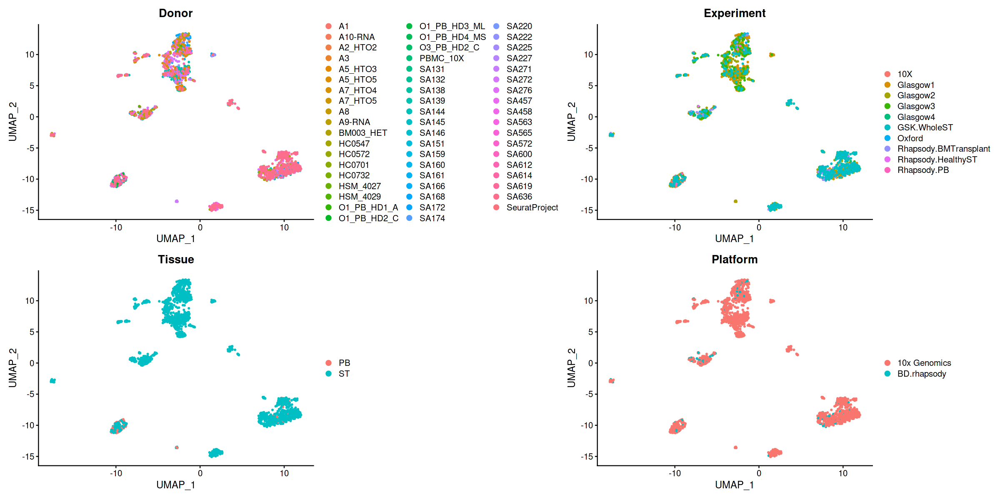

In [47]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(cycling, group.by=c("Donor","Experiment","Tissue","Platform"))

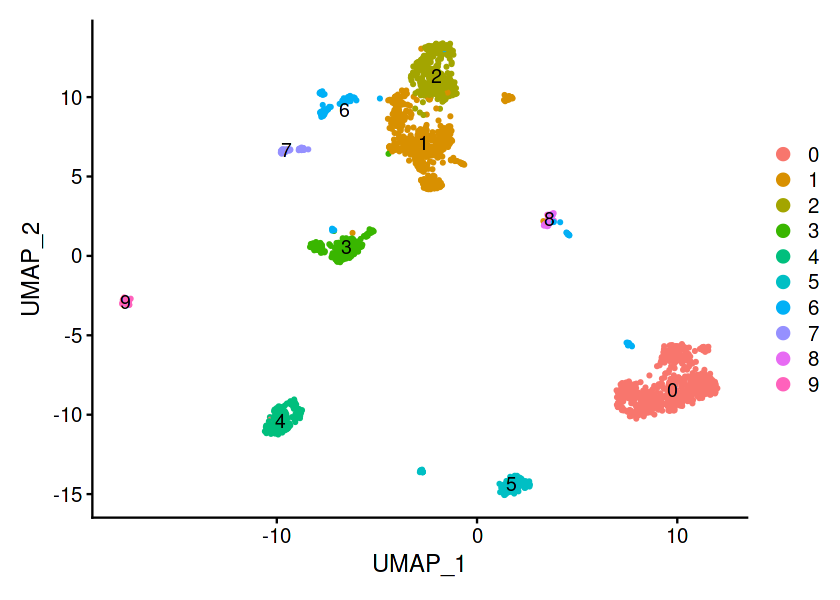

In [48]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(cycling, label=TRUE)

In [49]:
cluster.markers <- FindAllMarkers(subset(cycling, downsample = 500), only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  12% with 0 failures

 Completed [====


 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [===========================


 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>--


 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>---------


 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>-----------------


 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 2


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Complet


 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>


 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>--------


 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>--------------


 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 4


 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Complet


 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>-


 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>--------


 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>--------------


 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 6


 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Complet

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------] 


 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>------------------


 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [===========================


 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [===========================


 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>--


 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>------------


 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 9


 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Complet


 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [===========================


 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>

In [50]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

In [51]:
top10[top10$cluster=="21",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>


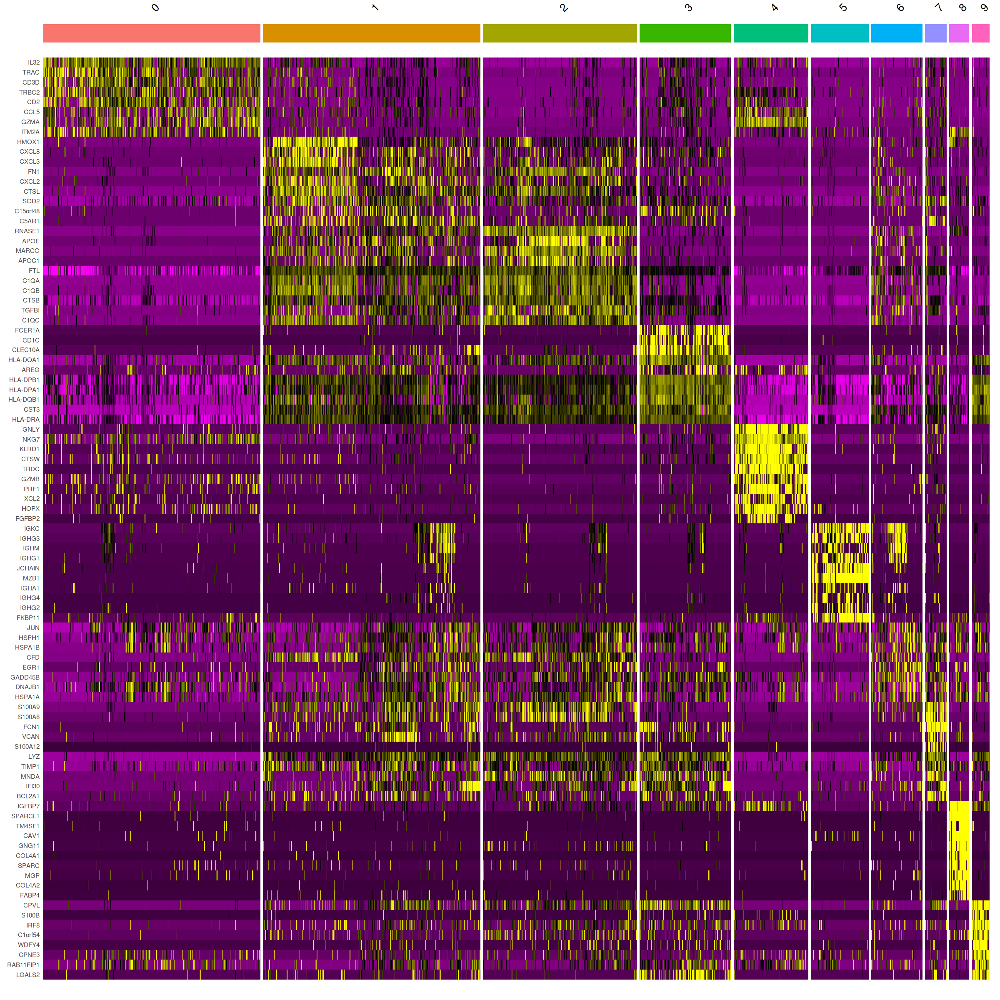

In [52]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(subset(cycling, downsample = 500), features=unique(top10$gene)) + NoLegend()

# Subset contaminants, re-integrate and cluster

In [53]:
#Keep only those cycling in synovium
to.remove <- subset(cycling, subset=Tissue=="ST")

In [56]:
#Remove all cells that are not cycling macrophage
to.remove <- subset(cycling, idents=c("1","2"), invert=TRUE)

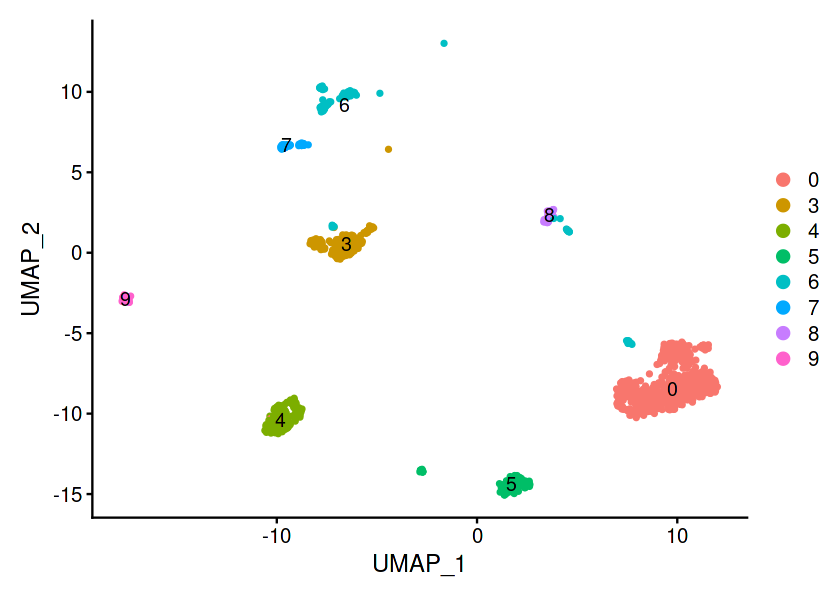

In [57]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(to.remove, label=TRUE)

In [58]:
myeloid <- subset(myeloid, cells = Cells(to.remove), invert=TRUE)

In [59]:
#Continue with typical preprocessing pipeline
myeloid <- myeloid %>%
    NormalizeData() %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData() %>% RunPCA()

Centering and scaling data matrix

PC_ 1 
Positive:  C1QA, RNASE1, C1QB, C1QC, LMNA, LGMN, CD63, GPNMB, PLTP, FOLR2 
	   FTL, VSIG4, CTSL, MARCO, DAB2, A2M, EMP1, PMP22, CD81, NUPR1 
	   CTSZ, HLA-DRB1, MSR1, HLA-DPB1, LILRB5, MS4A4A, HSPB1, CFD, IFI27, C2 
Negative:  FCN1, RIPOR2, CD48, RAC2, LYST, LCP1, VSIR, VCAN, LIMD2, CD52 
	   FGR, MNDA, LSP1, ITGA4, MEGF9, SELL, POU2F2, ITGAL, CASP1, CPPED1 
	   SERPINA1, CSF3R, SPN, MPEG1, CDC42EP3, FYB1, JAML, PRKCB, LYZ, S100A12 
PC_ 2 
Positive:  MT-ND5, MT-ATP8, RHOB, MT-ATP6, FYB1, JUN, MT-ND1, SELENOP, MT-ND2, MT-ND4L 
	   ADA2, KLF4, CD4, KLF2, TXNIP, KLF6, ZFP36L1, UCP2, SPI1, ZYX 
	   MATR3, CD84, ZFP36L2, LILRB5, COLEC12, PECAM1, ADAP2, EGR1, SAMHD1, ALDH1A1 
Negative:  RPS17, ALDOA, TIMP1, C15orf48, RPL17, CREM, EREG, MIF, LGALS1, GPR183 
	   FABP5, LGALS2, AREG, PLAUR, CFP, CXCR4, IFI30, SDS, MT2A, CRIP1 
	   GPAT3, SAMSN1, ISG20, CLEC10A, PHLDA1, THBS1, G0S2, S100A6, SOD2, AVPI1 
PC_ 3 
Positive:  NR4A3, ZNF331, BTG1, SELENOK, CRE

In [61]:
#Preintegration
myeloid <- RunUMAP(object = myeloid, reduction = "pca", dims = 1:40)

14:01:29 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

14:01:29 Read 84287 rows and found 40 numeric columns

14:01:29 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

14:01:29 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:01:41 Writing NN index file to temp file /datastore/lucy/tmp//file39fe24ee29e5c

14:01:41 Searching Annoy index using 1 thread, search_k = 3000

14:02:18 Annoy recall = 100%

14:02:19 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:02:22 Initializing from normalized Laplac

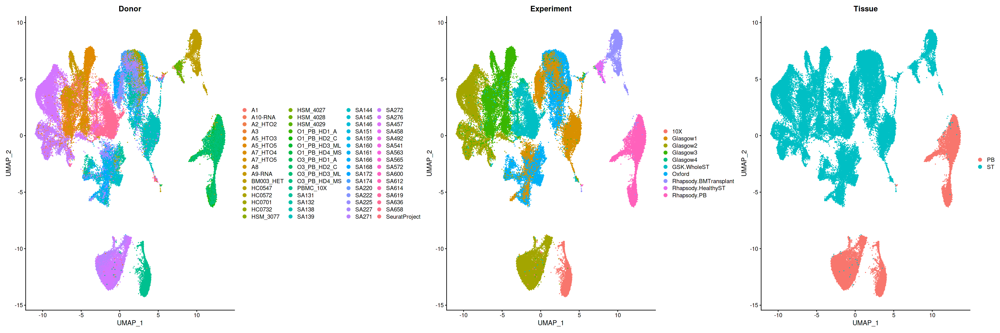

In [62]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue"))

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony 7/10

Harmony 8/10

Harmony 9/10

Harmony 10/10

Harmony converged after 10 iterations



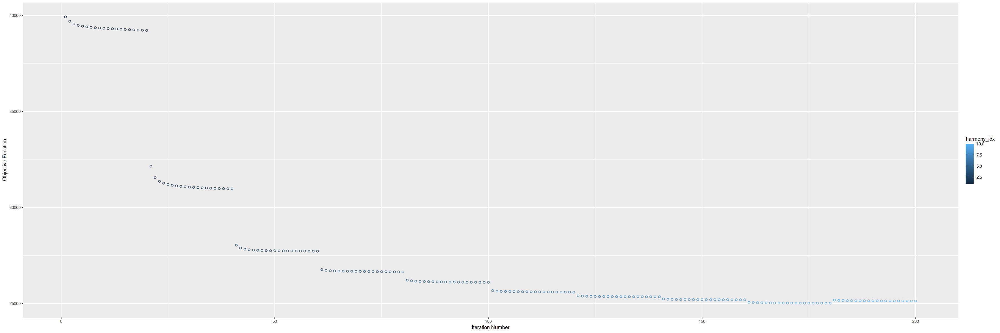

In [63]:
#Harmonize
myeloid <- myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,0,1))

In [64]:
#Run UMAP and clustering
myeloid <- RunUMAP(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=0.8)

14:34:39 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

14:34:39 Read 84287 rows and found 40 numeric columns

14:34:39 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

14:34:39 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:34:52 Writing NN index file to temp file /datastore/lucy/tmp//file39fe242a1778e5

14:34:52 Searching Annoy index using 1 thread, search_k = 3000

14:35:42 Annoy recall = 100%

14:35:43 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:35:47 Initializing from normalized Lapla

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 84287
Number of edges: 2593390

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8716
Number of communities: 25
Elapsed time: 60 seconds


2 singletons identified. 23 final clusters.



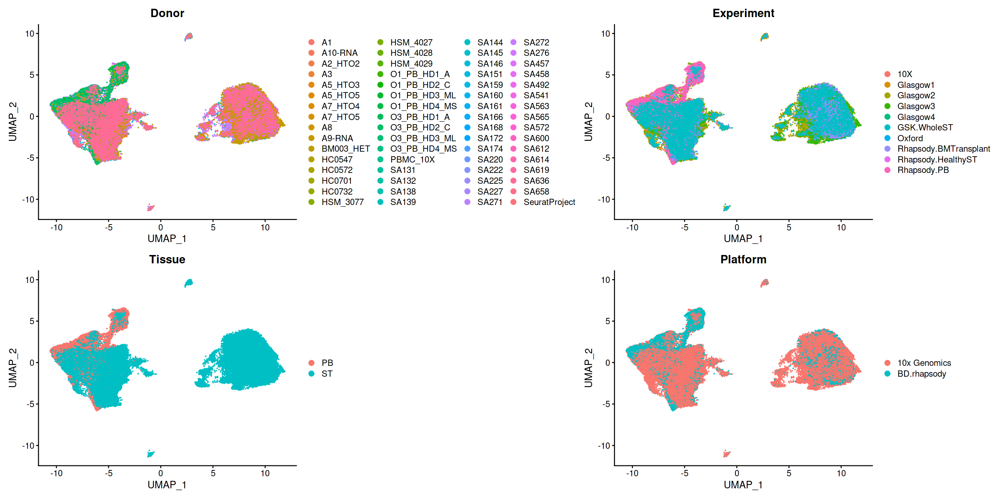

In [65]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue","Platform"))

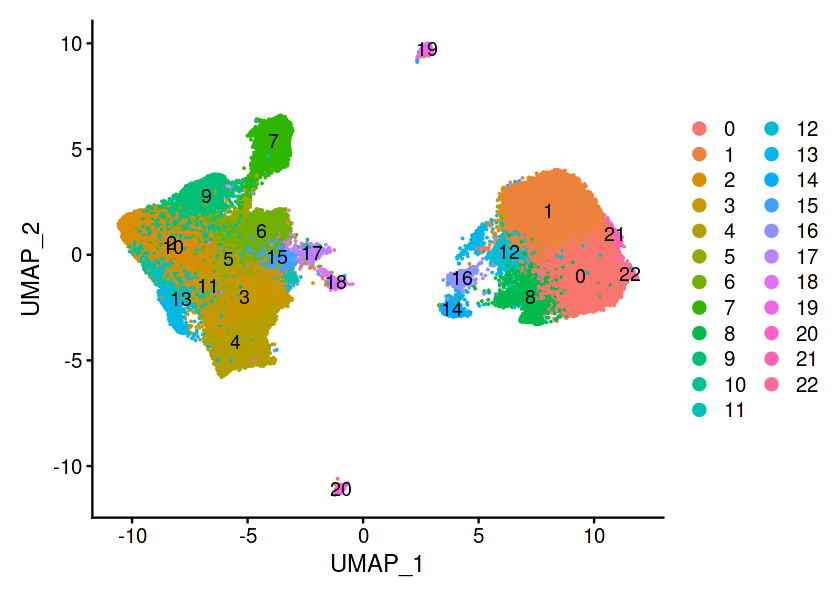

In [66]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

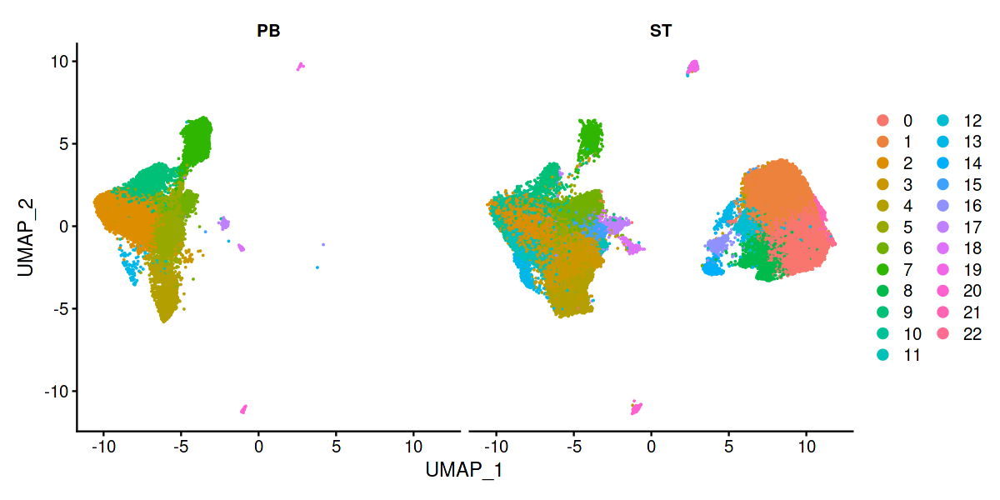

In [67]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, split.by="Tissue")

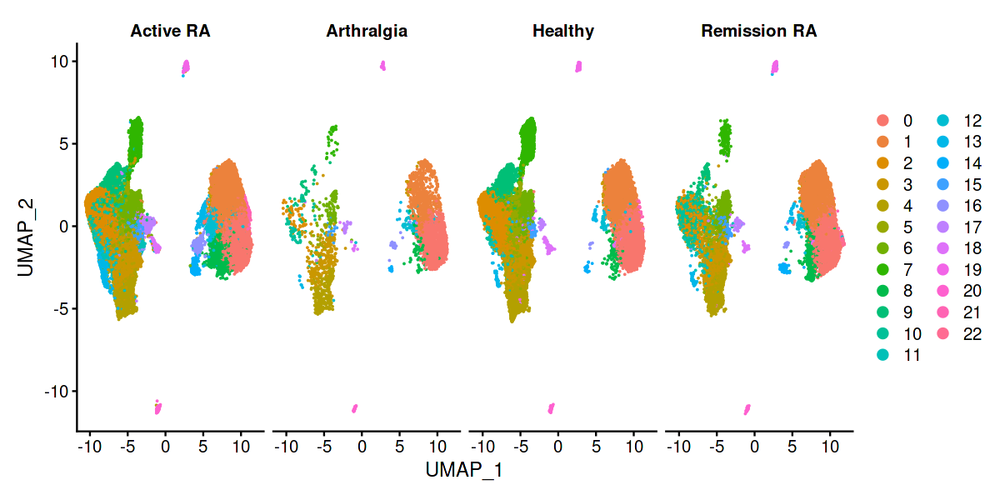

In [68]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, split.by="condition")

In [69]:
cluster.markers <- FindAllMarkers(subset(myeloid, downsample = 500), only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [====


 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [===========================


 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===========================


 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>---


 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>-----------


 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>-------------------


 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [===========================


 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>------


 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>-------------


 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>---------------------


 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [=====================================>------]  88% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================


 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>---------


 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>---------------------


 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [===========================


 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>-----------


 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>----------


 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>-----------------------


 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [===========================


 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================


 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>-------


 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>-----------------


 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [===========================


 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [===========================

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>--------


 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>-----------------


 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 11


 Completed [=>------------------------------------------]   3% with 0 failures

 Comple

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [============================


 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [===========================

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>------


 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>--------------


 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 13


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Comple

 Completed [=======================================>----]  91% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Ref


 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [============================


 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>---

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-------------


 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [======>--------------------


 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [=====================================>------]  88% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [===========================

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [============================


 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>-----

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>---------------


 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------


 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [===========================

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [============================

                                                                              


Done!

Calculating cluster 19


 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Comple

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [============================


 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>--

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>------------


 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>---------------------


 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [=====================================>------]  88% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [===========================

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [============================


 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>----

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>---------------


 Completed [=========================================>--]  97% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------


 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [===========================

In [70]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

In [76]:
top10[top10$cluster=="20",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.281043,0.611,0.013,0.000000e+00,20,S100B
0.000000e+00,2.856860,0.671,0.008,0.000000e+00,20,TACSTD2
0.000000e+00,2.588466,0.839,0.209,0.000000e+00,20,C1orf54
0.000000e+00,2.319138,0.899,0.620,0.000000e+00,20,CPVL
0.000000e+00,2.311206,0.759,0.221,0.000000e+00,20,CPNE3
2.080362e-104,2.215797,0.578,0.219,3.333780e-100,20,VMO1
1.651516e-146,2.201584,0.920,0.705,2.646554e-142,20,TXN
2.795447e-261,2.191760,0.604,0.016,4.479704e-257,20,IDO1
0.000000e+00,2.109434,0.925,0.657,0.000000e+00,20,SNX3


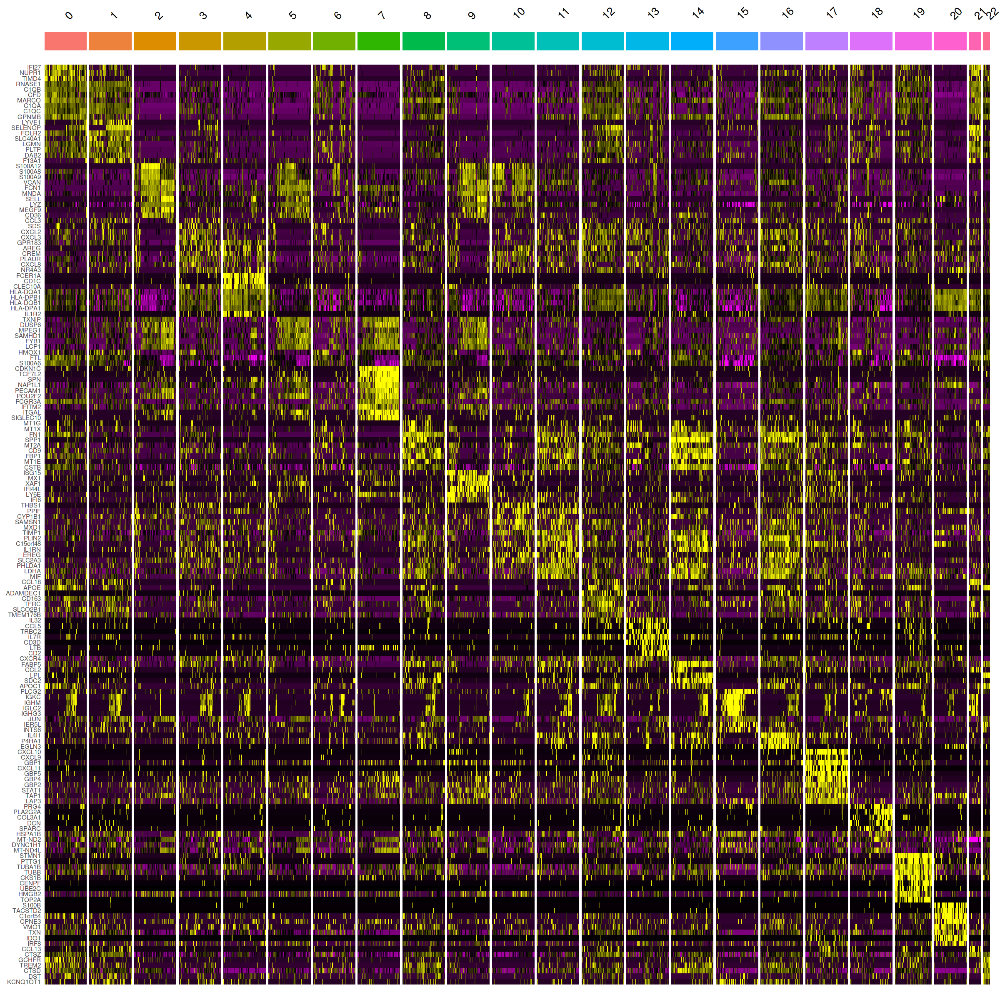

In [72]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(subset(myeloid, downsample = 500), features=unique(top10$gene)) + NoLegend()

# Subset contaminants, re-integrate and cluster

In [77]:
myeloid <- subset(myeloid, idents=c("13","15","18","20"), invert=TRUE)

In [ ]:
#Continue with typical preprocessing pipeline
myeloid <- myeloid %>%
    NormalizeData() %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData() %>% RunPCA()

Centering and scaling data matrix



In [ ]:
#Preintegration
myeloid <- RunUMAP(object = myeloid, reduction = "pca", dims = 1:40)

In [ ]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue"))

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony 7/10

Harmony 8/10

Harmony 9/10

Harmony converged after 9 iterations



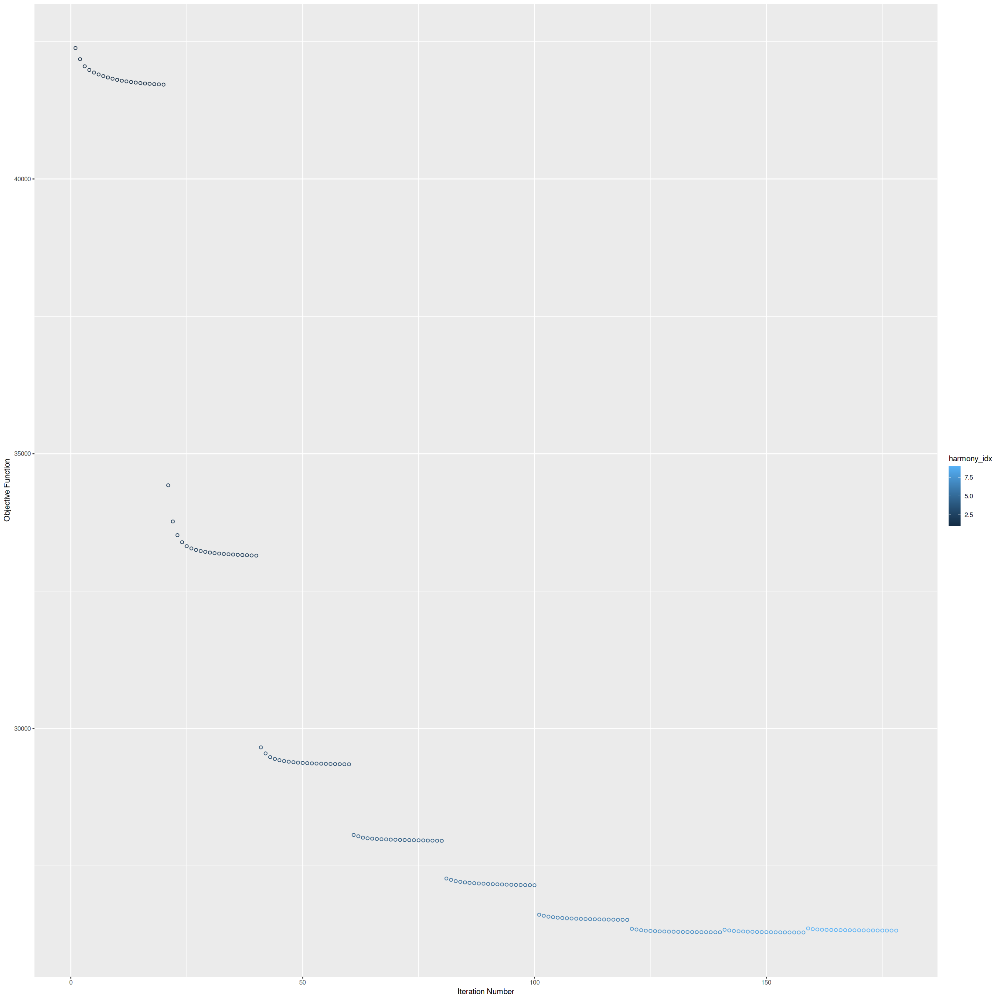

In [92]:
#Harmonize
myeloid <- myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,1))

In [93]:
#Run UMAP and clustering
myeloid <- RunUMAP(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=0.8)

10:22:20 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

10:22:20 Read 81527 rows and found 40 numeric columns

10:22:20 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

10:22:20 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:22:33 Writing NN index file to temp file /datastore/lucy/tmp//file39fe246530b812

10:22:33 Searching Annoy index using 1 thread, search_k = 3000

10:23:21 Annoy recall = 100%

10:23:23 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

10:23:27 Initializing from normalized Lapla

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 81527
Number of edges: 2430333

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8639
Number of communities: 23
Elapsed time: 70 seconds


4 singletons identified. 19 final clusters.



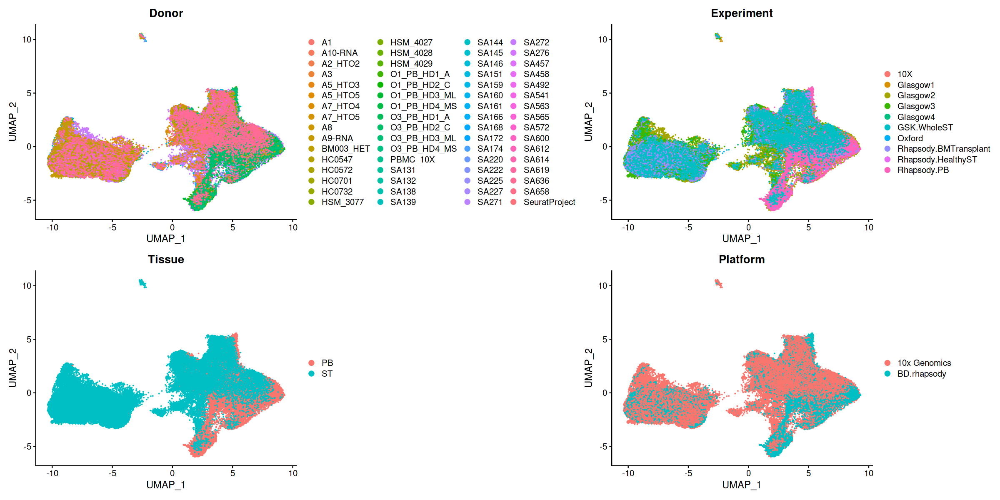

In [94]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue","Platform"))

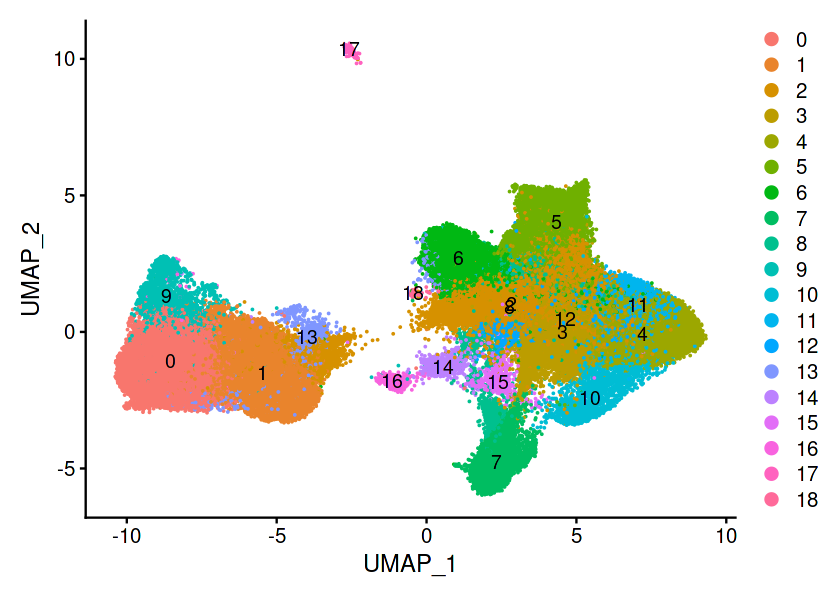

In [95]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

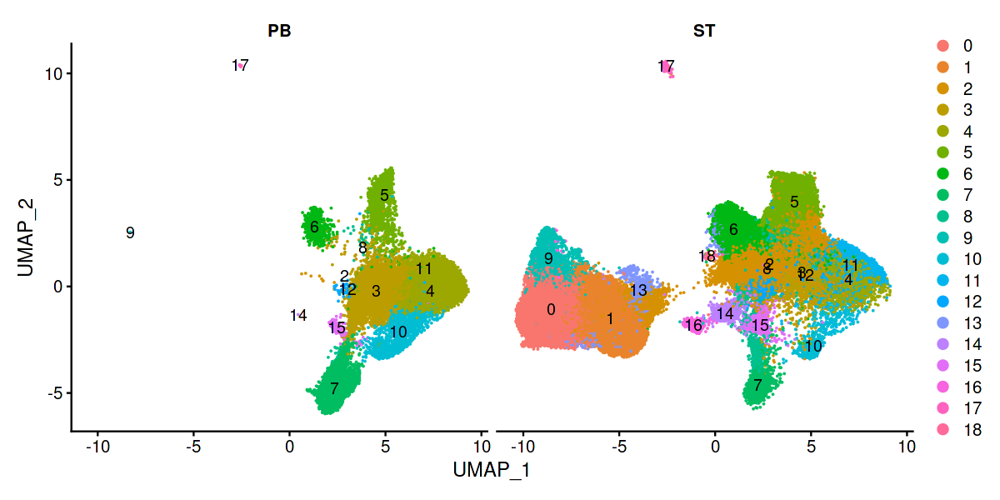

In [99]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, split.by="Tissue", label=TRUE)

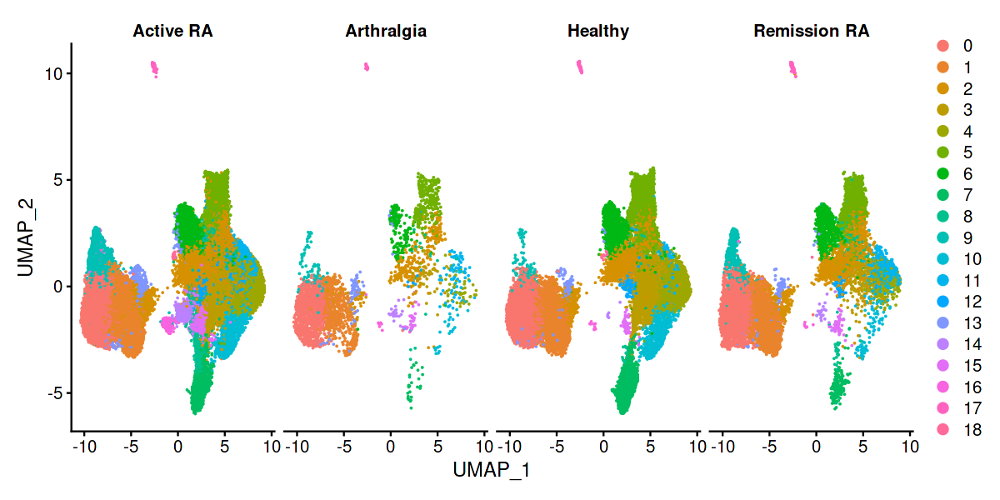

In [97]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, split.by="condition")

In [100]:
cluster.markers <- FindAllMarkers(subset(myeloid, downsample = 500), only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====


 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [===========================


 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===========================


 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>---


 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>----------


 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>----------------


 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------


 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [===========================


 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [===========================


 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>--------


 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>------------------


 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [===========================


 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>--------


 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>------------------


 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>-


 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>-------------


 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 8


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Complet


 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [===========================


 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [===========================


 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>---


 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>------------



Done!

Calculating cluster 10


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Compl


 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>------------


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>---------------------


 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [===========================

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [============================


 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>--

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>----------


 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>---------------

                                                                              


Done!

Calculating cluster 14


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Comple

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [============================


 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [===========================

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [===================>--------


 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>----------------


 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [=========================================>--]  97% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 16


 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Comple

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [============================


 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [===========================

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>------


 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>----------------


 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 18


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Comple

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [============================


 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [===========================

In [101]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

In [105]:
top10[top10$cluster=="9",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
5.697404e-107,2.905281,0.628,0.207,9.130090e-103,9,SPP1
1.379390e-162,1.932294,0.960,0.508,2.210472e-158,9,FN1
3.985704e-157,1.912519,0.430,0.042,6.387090e-153,9,LPL
5.799824e-164,1.776573,0.888,0.437,9.294219e-160,9,CD9
1.750080e-123,1.703366,0.926,0.512,2.804504e-119,9,FABP5
2.217158e-153,1.637428,0.854,0.427,3.552996e-149,9,FBP1
1.373588e-168,1.461223,0.998,0.867,2.201175e-164,9,CSTB
2.650605e-110,1.326979,0.558,0.149,4.247594e-106,9,SDC2
5.169986e-109,1.216248,0.884,0.441,8.284903e-105,9,EMP1


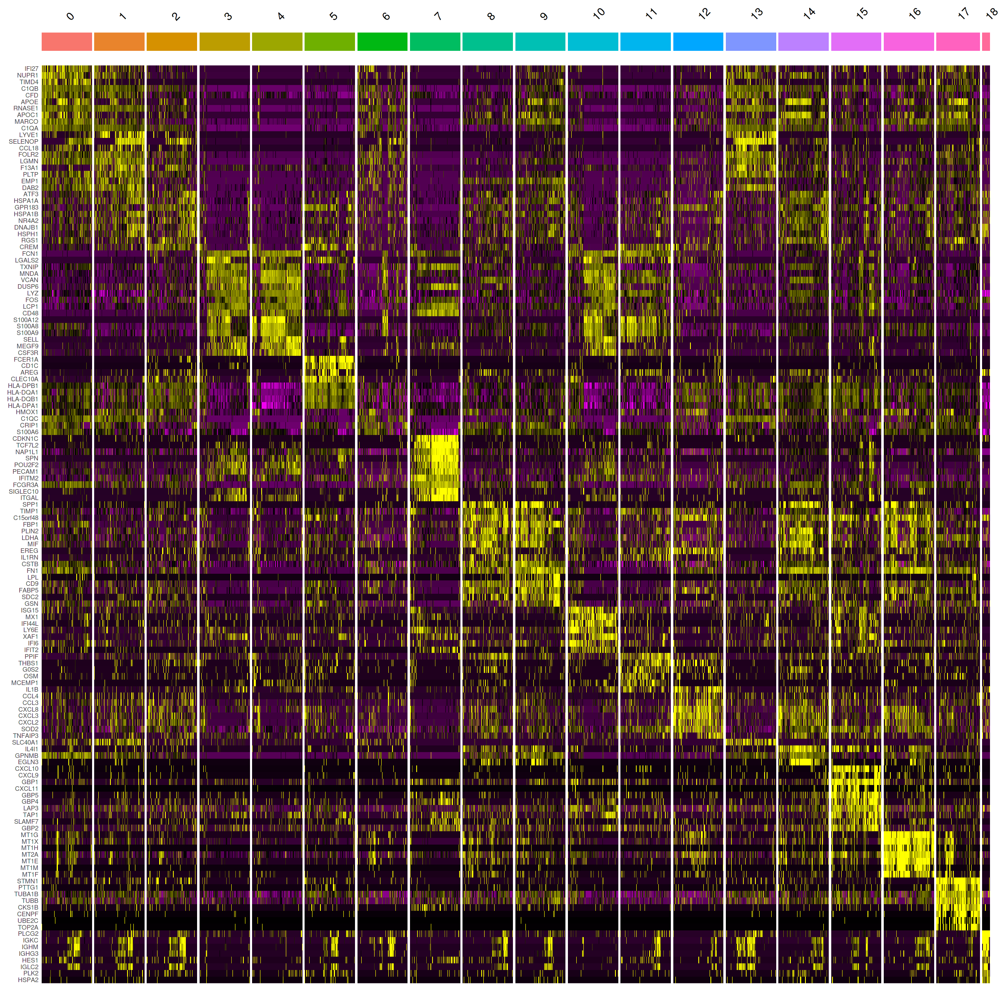

In [103]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(subset(myeloid, downsample = 500), features=unique(top10$gene)) + NoLegend()

In [91]:
saveRDS(myeloid, "myeloid.rds")

In [201]:
myeloid <- readRDS("myeloid.rds")

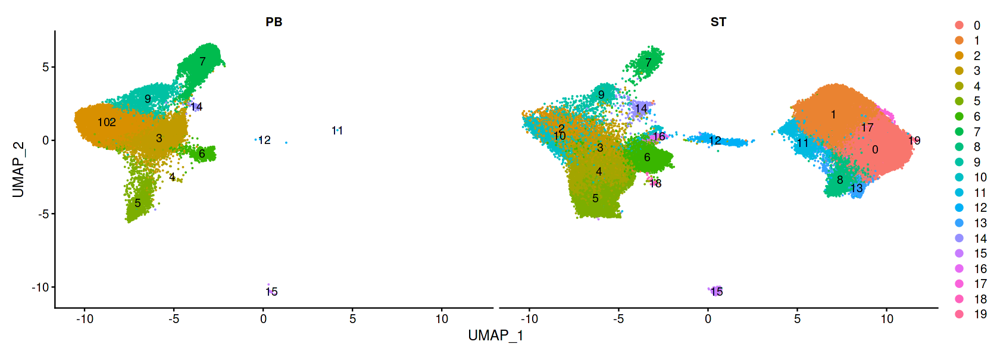

In [202]:
options(repr.plot.width=14, repr.plot.height=5)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [203]:
myeloid

An object of class Seurat 
16025 features across 81527 samples within 1 assay 
Active assay: RNA (16025 features, 2000 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

# Subset contaminants, re-integrate and cluster

In [204]:
#Remove cycling cells from the blood
myeloid <- subset(myeloid, subset = Tissue == "PB" & seurat_clusters == 15, invert=TRUE)

In [205]:
myeloid

An object of class Seurat 
16025 features across 81519 samples within 1 assay 
Active assay: RNA (16025 features, 2000 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

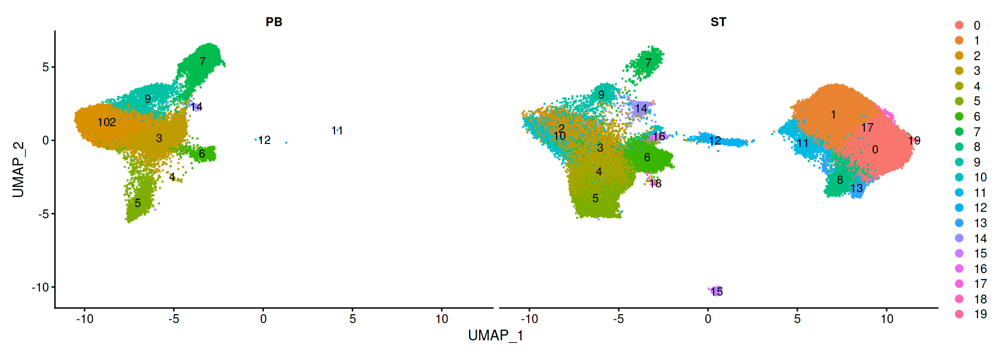

In [206]:
options(repr.plot.width=14, repr.plot.height=5)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [207]:
#Remove contaminants 
myeloid <- subset(myeloid, idents=c("13","18"), invert=TRUE)

Centering and scaling data matrix

PC_ 1 
Positive:  C1QA, RNASE1, C1QB, C1QC, LMNA, LGMN, CD63, GPNMB, PLTP, FTL 
	   FOLR2, VSIG4, CTSL, MARCO, DAB2, A2M, EMP1, PMP22, HLA-DRB1, CD81 
	   CTSZ, NUPR1, HLA-DPB1, MSR1, HSPB1, MS4A4A, LILRB5, CFD, C2, IFI27 
Negative:  FCN1, CD48, RIPOR2, RAC2, LYST, LCP1, VSIR, VCAN, LIMD2, CD52 
	   FGR, LSP1, MNDA, ITGA4, MEGF9, SELL, POU2F2, ITGAL, CASP1, SERPINA1 
	   CPPED1, CSF3R, MPEG1, SPN, CDC42EP3, FYB1, LYZ, PRKCB, JAML, LRRK2 
PC_ 2 
Positive:  MT-ND5, MT-ATP8, RHOB, MT-ATP6, JUN, FYB1, AHNAK, MT-ND1, MT-ND2, SELENOP 
	   MT-ND4L, KLF4, ADA2, CD4, KLF2, KLF6, TXNIP, ZFP36L1, UCP2, SPI1 
	   MATR3, ZFP36L2, ZYX, CD84, LILRB5, COLEC12, EGR1, SAMHD1, ADAP2, PECAM1 
Negative:  RPS17, ALDOA, TIMP1, C15orf48, RPL17, CREM, LGALS1, MIF, EREG, GPR183 
	   LGALS2, FABP5, CFP, AREG, PLAUR, IFI30, CXCR4, S100A6, SDS, SAMSN1 
	   CRIP1, CLEC10A, GPAT3, ISG20, G0S2, PHLDA1, THBS1, MT2A, AVPI1, SOD2 
PC_ 3 
Positive:  NR4A3, BTG1, CREM, ZNF331, SELENOK, G

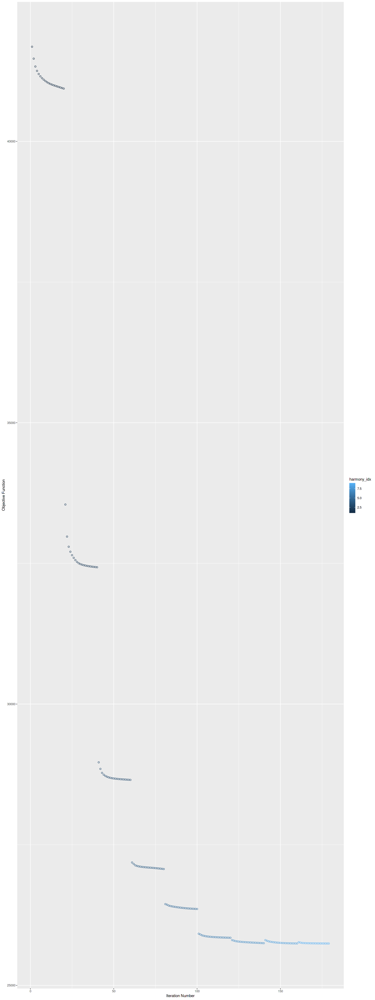

In [272]:
#Continue with typical preprocessing pipeline
myeloid <- FindVariableFeatures(myeloid, selection.method = "vst", nfeatures = 2000)
myeloid <- ScaleData(myeloid)
myeloid <- RunPCA(myeloid)
myeloid <- myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,1))

In [361]:
#Run UMAP and clustering 
myeloid <- RunUMAP(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=1.6)

16:32:28 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

16:32:28 Read 80580 rows and found 40 numeric columns

16:32:28 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

16:32:28 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:32:40 Writing NN index file to temp file /datastore/lucy/tmp//file24d35012c17244

16:32:40 Searching Annoy index using 1 thread, search_k = 3000

16:33:27 Annoy recall = 100%

16:33:27 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:33:31 Initializing from normalized Lapla

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 80580
Number of edges: 2408931

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8096
Number of communities: 32
Elapsed time: 56 seconds


4 singletons identified. 28 final clusters.



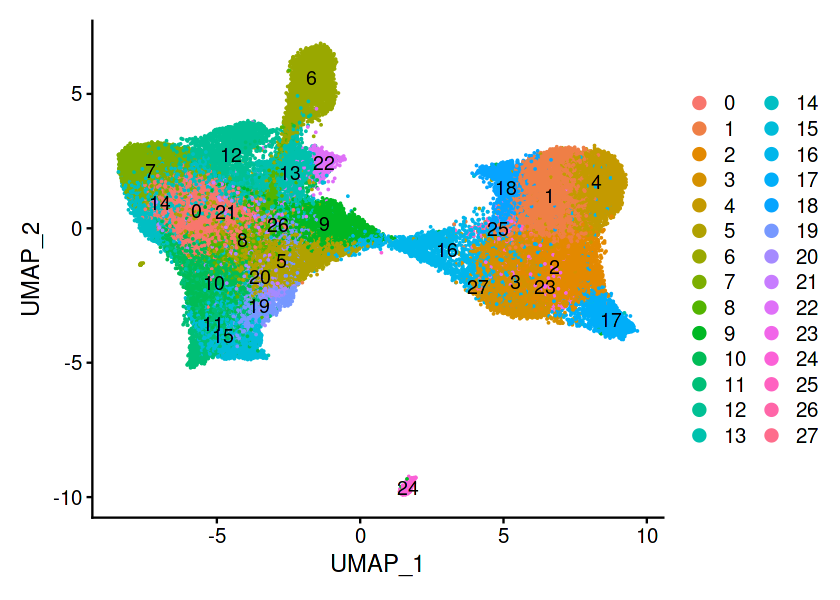

In [362]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

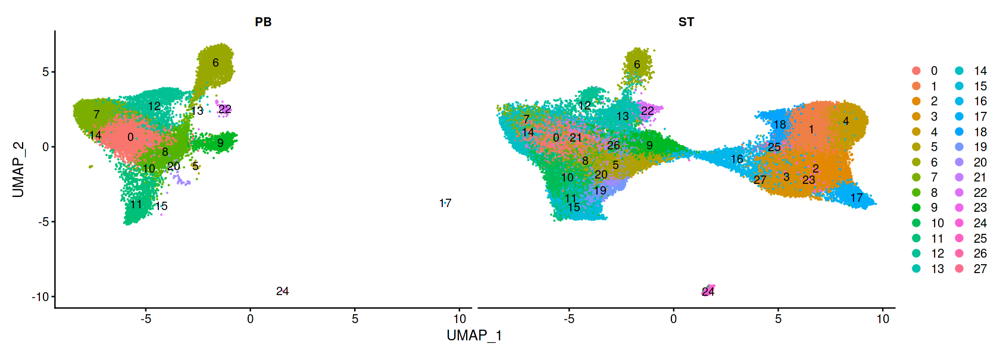

In [363]:
options(repr.plot.width=14, repr.plot.height=5)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [276]:
genes<- c("VSIG4","TREM2","SPP1","LYVE1")

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


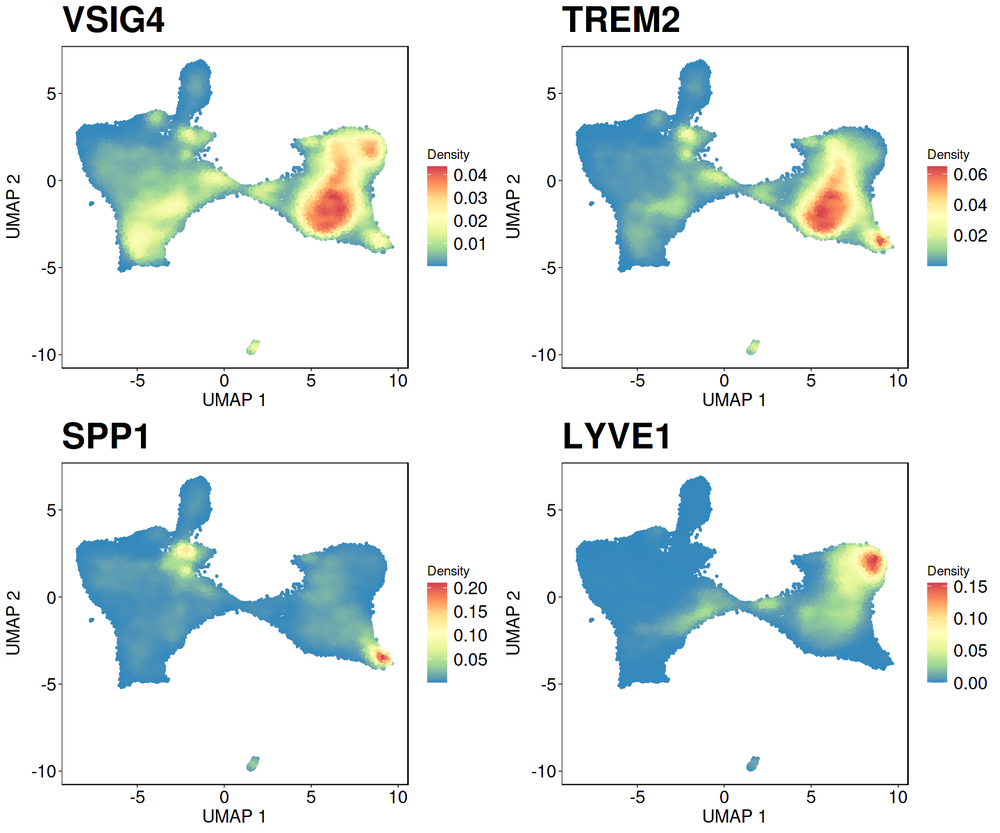

In [277]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(myeloid,gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15)) + scale_color_distiller(palette = "Spectral")  }

plot_grid(plotlist=x, ncol=2)

# Find cluster markers

In [364]:
cluster.markers <- FindAllMarkers(subset(myeloid, downsample = 500), only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====


 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>


 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [===============>-----------


 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>--------------------


 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [=====================================>------]  88% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [===========================


 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [===========================


 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>--


 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>-----------


 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>-------------------


 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [===========================


 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [===========================


 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [===================>------------------------]  47% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>---


 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>----------


 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>---------------


 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>---------------------


 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [===========================


 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>-


 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>------------

Refitting on reduced model...


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Complet


 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [===========================


 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>--------


 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>---------


 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [===========================

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [============================


 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>------

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>----------------


 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [>-------------------------------------


 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [===========================

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>----


 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>--------------


 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 13


 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Comple

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [============================


 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [===================>------------------------]  47% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>-----

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>------------------


 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Re


 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===========================

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-


 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>-----------

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>--------------------


 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                        


 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [===========================

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-


 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [===============>----------------------------]  38% with 0 failures

 Completed [================>----------

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>----------------------


 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [===========================


 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [===========================

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>-----


 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>-----------

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>-----------------


 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>-------------------


 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 21


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Comple

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [============================


 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [===========================

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>--


 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>---------

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>------------------


 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [=========================================>--]  97% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                        


 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [===========================

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [===================>------------------------]  47% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>----


 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>---------------


 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Calculating cluster 25


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Comple

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [==============================>-------------]  72% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [============================


 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>----

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>---------------


 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------


 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [===========================

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>--


 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>-----------

In [365]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

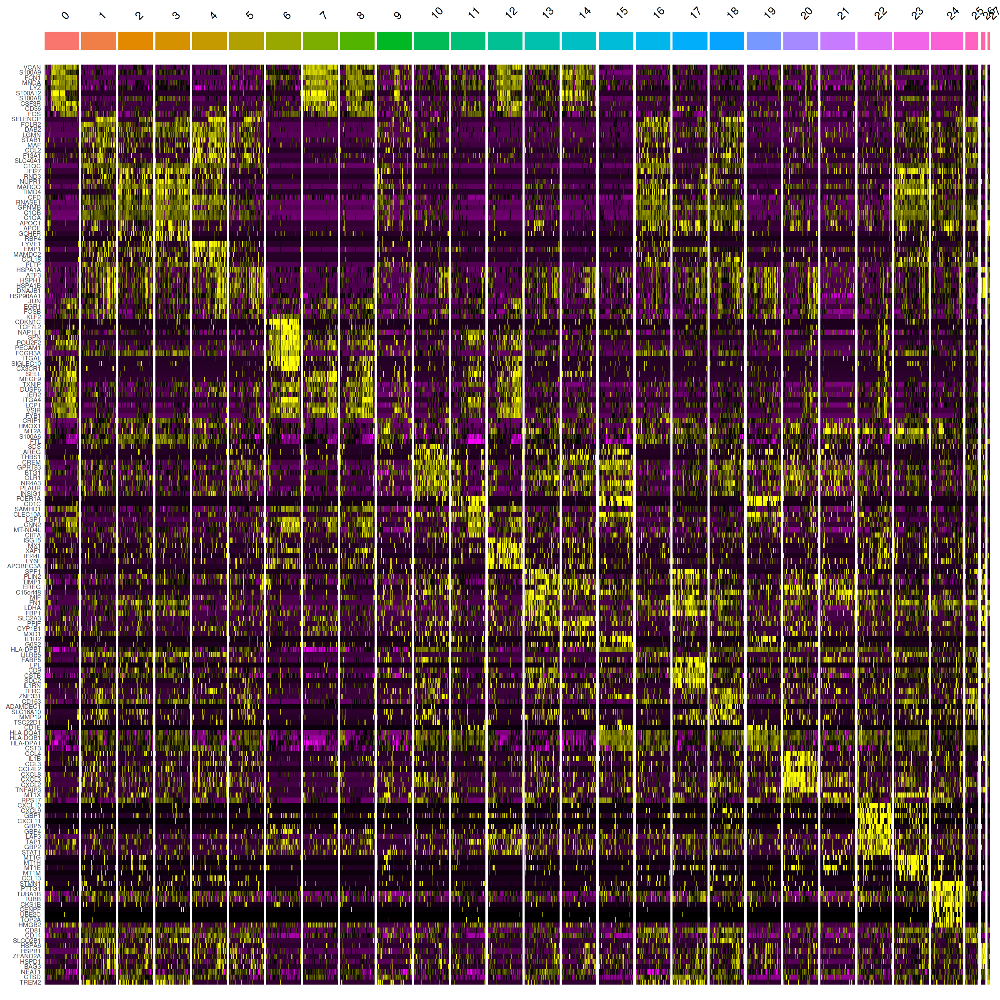

In [366]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(subset(myeloid, downsample = 500), features=unique(top10$gene)) + NoLegend()

In [367]:
Idents(myeloid) <- "seurat_clusters"

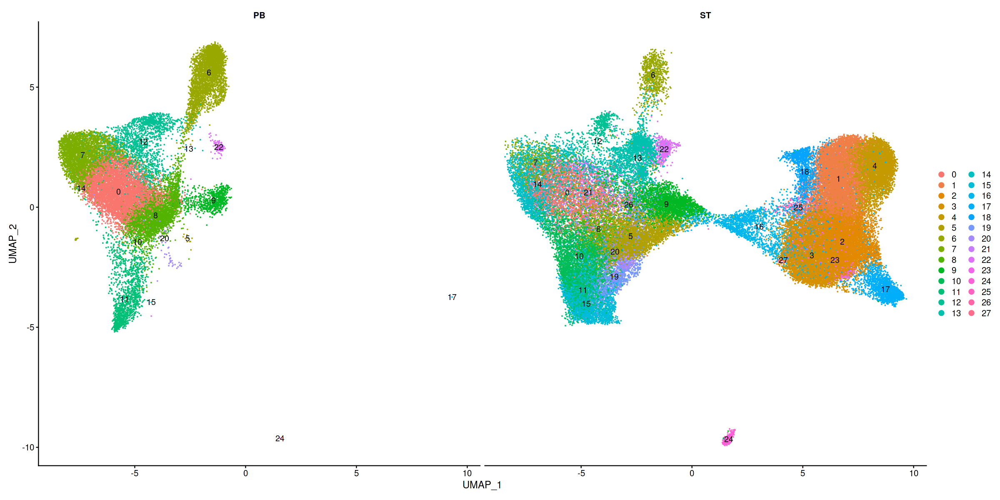

In [368]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [397]:
top10[top10$cluster=="27",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
5.473740e-24,2.678187,0.972,0.340,8.771668e-20,27,APOE
1.609931e-20,2.441962,0.944,0.310,2.579915e-16,27,APOC1
3.176057e-30,2.293821,0.917,0.188,5.089631e-26,27,GCHFR
2.290365e-41,2.212468,0.972,0.061,3.670309e-37,27,LPL
1.178236e-16,1.915121,0.972,0.509,1.888124e-12,27,FN1
3.377692e-19,1.812777,1.000,0.998,5.412752e-15,27,FTL
2.810045e-14,1.620009,1.000,0.958,4.503098e-10,27,NEAT1
1.085817e-15,1.459078,1.000,0.738,1.740021e-11,27,CTSD
1.918122e-21,1.451400,0.972,0.244,3.073790e-17,27,TREM2


# Rename clusters

In [416]:
Idents(myeloid) <- "seurat_clusters"
myeloid$clusters <- plyr::revalue(as.character(Idents(myeloid)),
                                        c("0" = 'CD14highS100A12+ Monocyte',
                                          "1"='FOLR2highSELENOP+ Macrophage',
                                          "2"='VSIG4+TREM2+ Macrophage',
                                          "3"='VSIG4+TREM2+ Macrophage',
                                         "4"='FOLR2highLYVE1+ Macrophage',
                                          "5"="KLF2+ATF3+EGR1+ Macrophage",
                                         "6"='FCGR3A+ Monocyte',
                                          "7"='CD14highS100A12+ Monocyte',
                                          "8"='CD14+FCGR3A+ Monocyte',
                                          "9"='HMOX1+CRIP1+ Intermediate',
                                         "10"="SDS+NR4A3+CXCR4+ iDC3",
                                          "11"="CD1c+ cDC",
                                         "12"="ISG15+CXCL10+ Intermediate",
                                          "13"="SPP1+FCN1+ Macrophage",
                                          "14"="CD14highS100A12+ Monocyte",
                                          "15"='CD1c+ cDC',
                                         "16"='FOLR2highC1QA+ Macrophage',
                                          "17"='SPP1+TREM2+ Macrophage',
                                         "18"='FOLR2highCLEC10A+ Macrophage',
                                          "19"='CD1c+ cDC',
                                         "20"='IL1B+CXCL8+ Macrophage',
                                          "21"='SPP1+FCN1+ Macrophage',
                                         "22"='CXCL10+STAT1+ Macrophage',
                                         "23"='VSIG4+TREM2+ Macrophage',
                                         "24"='BIRC5+ cycling precursors',
                                         "25"='FOLR2highC1QA+ Macrophage',
                                         "26"='HMOX1+CRIP1+ Intermediate',
                                         "27"='VSIG4+TREM2+ Macrophage'))



In [417]:
unique(myeloid$clusters)

[1] "FOLR2highSELENOP+ Macrophage" "HMOX1+CRIP1+ Intermediate"   
 [3] "VSIG4+TREM2+ Macrophage"      "SDS+NR4A3+CXCR4+ iDC3"       
 [5] "CD14+FCGR3A+ Monocyte"        "FOLR2highLYVE1+ Macrophage"  
 [7] "KLF2+ATF3+EGR1+ Macrophage"   "CD1c+ cDC"                   
 [9] "BIRC5+ cycling precursors"    "FOLR2highC1QA+ Macrophage"   
[11] "CXCL10+STAT1+ Macrophage"     "ISG15+CXCL10+ Intermediate"  
[13] "CD14highS100A12+ Monocyte"    "FCGR3A+ Monocyte"            
[15] "IL1B+CXCL8+ Macrophage"       "SPP1+TREM2+ Macrophage"      
[17] "FOLR2highCLEC10A+ Macrophage" "SPP1+FCN1+ Macrophage"

In [48]:
myeloid$clusters <- as.ordered(factor(myeloid$clusters, levels=c("CD14highS100A12+ Monocyte",
"CD14+FCGR3A+ Monocyte",
"FCGR3A+ Monocyte",
'ISG15+CXCL10+ Intermediate',
"CXCL10+STAT1+ Macrophage",
'SPP1+FCN1+ Macrophage',                                                                
"HMOX1+CRIP1+ Intermediate",                                                                
'IL1B+CXCL8+ Macrophage',
'SDS+NR4A3+CXCR4+ iDC3',
"CD1c+ cDC",                                                                
'KLF2+ATF3+EGR1+ Macrophage', 
"FOLR2highCLEC10A+ Macrophage",
"FOLR2highSELENOP+ Macrophage",
"FOLR2highLYVE1+ Macrophage",                                                                 
"FOLR2highC1QA+ Macrophage",
"VSIG4+TREM2+ Macrophage",
"SPP1+TREM2+ Macrophage",                                                                 
"BIRC5+ cycling precursors"                                                                
)))
Idents(myeloid) <- "clusters"


cols <- c("CD14highS100A12+ Monocyte"="#FFC2CB",
"CD14+FCGR3A+ Monocyte"="#FF7FD1",
"FCGR3A+ Monocyte"="#9583F0",
'SPP1+FCN1+ Macrophage'="red3",
'ISG15+CXCL10+ Intermediate'="deeppink1",
"CXCL10+STAT1+ Macrophage"="magenta4",
"FOLR2highLYVE1+ Macrophage"="#0cc6f0",
"FOLR2highSELENOP+ Macrophage"="#52ecf7",
"FOLR2highCLEC10A+ Macrophage"="#96ffec",          
'KLF2+ATF3+EGR1+ Macrophage'="#32fac5", 
"HMOX1+CRIP1+ Intermediate"="orange",
"FOLR2highC1QA+ Macrophage" ="dodgerblue2",
"IL1B+CXCL8+ Macrophage"="yellow",
'SDS+NR4A3+CXCR4+ iDC3'="#DFFF00",
"CD1c+ cDC"="#0ced22",
"BIRC5+ cycling precursors"="magenta",
"SPP1+TREM2+ Macrophage"="#710af7",
"VSIG4+TREM2+ Macrophage"="dodgerblue4"         
)

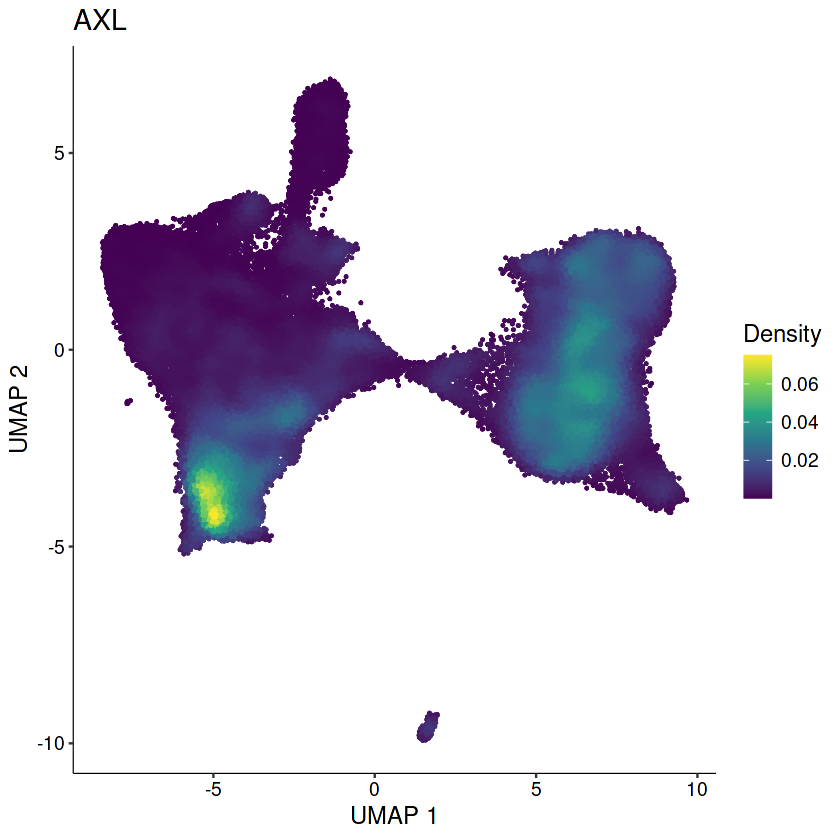

In [5]:
plot_density(myeloid, "AXL", reduction="umap")

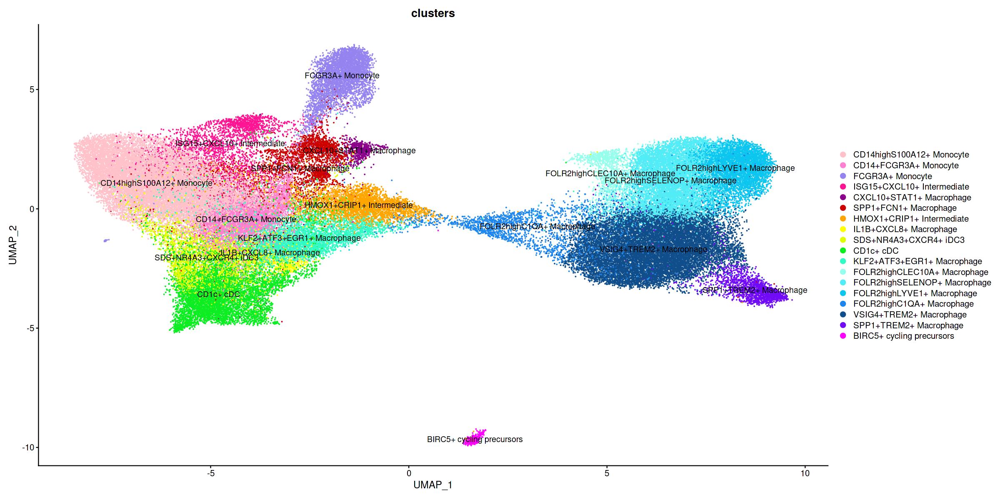

In [451]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, label=TRUE, group.by="clusters", cols=cols)

In [118]:
myeloid

An object of class Seurat 
16738 features across 80580 samples within 2 assays 
Active assay: RNA (16025 features, 2000 variable features)
 1 other assay present: TFA
 3 dimensional reductions calculated: pca, harmony, umap

In [4]:
table(myeloid$Tissue)


   PB    ST 
20073 60507 

In [9]:
unique(myeloid$sample)

[1] "HC0547"       "HC0572"       "HC0732"       "SA138"        "SA146"       
 [6] "SA172"        "SA132"        "SA160"        "SA161"        "SA174"       
[11] "SA144"        "SA151"        "SA166"        "HC0701"       "SA131"       
[16] "SA145"        "SA139"        "SA159"        "SA168"        "SA220"       
[21] "SA222"        "SA225"        "SA227"        "SA272"        "SA271"       
[26] "SA276"        "PBMC_10X"     "A1"           "A10-RNA"      "A2_HTO2"     
[31] "A5_HTO5"      "A5_HTO3"      "A7_HTO5"      "A7_HTO4"      "A8"          
[36] "A9-RNA"       "A3"           "O1_PB_HD1_A"  "O1_PB_HD3_ML" "O1_PB_HD2_C" 
[41] "O1_PB_HD4_MS" "O3_PB_HD4_MS" "O3_PB_HD3_ML" "O3_PB_HD2_C"  "O3_PB_HD1_A" 
[46] "H1-RNA"       "H2-RNA"       "H34-RNA"      "HSM_4029"     "HSM_4028"    
[51] "HSM_4027"     "HSM_3077"     "BM003_HET"    "SA572"        "SA457"       
[56] "SA492"        "SA458"        "SA565"        "SA563"        "SA614"       
[61] "SA541"        "SA612"        "SA619"        "SA600"        "SA636"       
[66] "SA658"

In [10]:
table(myeloid$Donor, myeloid$Tissue)

                               
                                  PB   ST
  Arthralgia_BM003_HET             0 3121
  Healthy_A2_HTO2                  0  134
  Healthy_A5_HTO5                  0 3723
  Healthy_A7_HTO5                  0  583
  Healthy_H1-RNA                   0   59
  Healthy_H2-RNA                   0 1514
  Healthy_H34-RNA                  0    8
  Healthy_HC0547                   0  716
  Healthy_HC0572                   0 1522
  Healthy_HC0701                   0 1903
  Healthy_HC0732                   0  660
  Healthy_HSM_3077                 0   11
  Healthy_HSM_4027                 0   64
  Healthy_HSM_4028                 0   25
  Healthy_HSM_4029                 0  580
  Naive RA_SA131                   0  459
  Naive RA_SA138                   0 1144
  Naive RA_SA139                   0 4828
  Naive RA_SA146                   0 1373
  Naive RA_SA172                   0 1670
  Naive RA_SA220                   0  421
  Naive RA_SA271                3027 1034
  

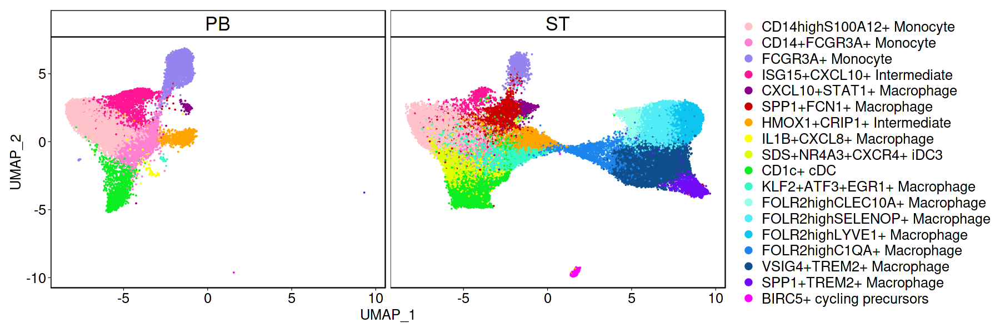

In [452]:
options(repr.plot.width=15, repr.plot.height=5)
DimPlot(myeloid,  split.by="Tissue", cols=cols) + theme_specific + theme(plot.title=element_blank(),legend.text=element_text(size=15))

In [134]:
saveRDS(myeloid, "renamed.myeloid.rds")

In [7]:
myeloid <- readRDS("renamed.myeloid.rds")

In [19]:
unique(myeloid$Experiment)

[1] "Oxford"                "Glasgow1"              "Glasgow2"             
 [4] "10X"                   "Glasgow3"              "Rhapsody.PB"          
 [7] "Glasgow4"              "Rhapsody.HealthyST"    "Rhapsody.BMTransplant"
[10] "GSK.WholeST"

In [12]:
GSK <- subset(myeloid, subset = Experiment == "GSK.WholeST")

In [13]:
unique(GSK$Donor)

[1] "Remission RA_Sustained_SA572" "Remission RA_Sustained_SA457"
 [3] "Remission RA_Flare_SA492"     "Remission RA_Sustained_SA458"
 [5] "Remission RA_Sustained_SA565" "Remission RA_Sustained_SA563"
 [7] "Resistant RA_SA614"           "Remission RA_Sustained_SA541"
 [9] "Naive RA_SA612"               "Remission RA_Sustained_SA619"
[11] "Resistant RA_SA600"           "Naive RA_SA636"              
[13] "Remission RA_Unknown_SA658"

In [20]:
rhapsody <- subset(myeloid, subset = Experiment %in% c('Rhapsody.HealthyST','Rhapsody.BMTransplant'))

In [21]:
unique(rhapsody$Donor)

[1] "Healthy_HSM_4029"     "Healthy_HSM_4028"     "Healthy_HSM_4027"    
[4] "Healthy_HSM_3077"     "Arthralgia_BM003_HET"

# Fix metadata

In [8]:
myeloid$group <- plyr::revalue(as.character(myeloid$Donor),
                                c("H1-RNA"= 'Healthy',
                                  "H2-RNA"= 'Healthy',
                                  "H34-RNA"= 'Healthy',
                                  "HSM_3077"= 'Healthy',
                                  "HSM_4027"= 'Healthy',
                                  "HSM_4028"= 'Healthy',
                                  "HSM_4029"= 'Healthy',
                                    "HC0547" = 'Healthy',
                                  "HC0572" = 'Healthy',
                                  "HC0701" = 'Healthy',
                                  "HC0732" = 'Healthy',
                                  "A5_HTO5"='Healthy',
                                  "A2_HTO2"='Healthy',
                                  "A7_HTO5"='Healthy',
                                "SA131" = 'Naive RA',
                                  "SA138" = 'Naive RA',
                                  "SA146" = 'Naive RA',
                                  "SA172" = 'Naive RA',
                                  "SA139" = 'Naive RA',
                                  "SA220" = 'Naive RA',
                                  "SA271" = 'Naive RA',
                                  "SA276" = 'Naive RA',
                                  'SA636'='Naive RA',
                                  'SA612'='Naive RA',
                                  "SA144" = 'Resistant RA',
                                 "SA145" = 'Resistant RA',
                                  "SA151" = 'Resistant RA',
                                  "SA166" = 'Resistant RA',
                                 "SA222" = 'Resistant RA',
                                 "SA227" = 'Resistant RA',
                                 "SA272" = 'Resistant RA',
                                  "A1" = 'Resistant RA',
                                  "A3" = 'Resistant RA',
                                  "A5_HTO3"='Resistant RA',
                                  "A7_HTO4"='Resistant RA',
                                  "A8"='Resistant RA',
                                  'SA614'='Resistant RA',
                                  
                                  'SA600'='Resistant RA',
                                  
                                 "SA132" = 'Remission RA_Sustained',
                                 "SA160" = 'Remission RA_Sustained',
                                 "SA161" = 'Remission RA_Flare',
                                 "SA174" = 'Remission RA_Sustained',
                                 "SA159" = 'Remission RA_Flare',
                                 "SA168" = 'Remission RA_Flare',
                                 "SA225" = 'Remission RA_Sustained',
                                 "A10-RNA" = 'Remission RA_Flare',
                                 "A9-RNA" = 'Remission RA_Flare',
                                  'SA492'= 'Remission RA_Flare',
                                  'SA541'= 'Remission RA_Sustained',
                                  'SA457'= 'Remission RA_Sustained',
                                  'SA458'= 'Remission RA_Sustained',
                                  'SA563'= 'Remission RA_Sustained',
                                  'SA565'= 'Remission RA_Sustained',
                                  'SA572'= 'Remission RA_Sustained',
                                  'SA619'= 'Remission RA_Sustained',
                                  'SA658'= 'Remission RA_Unknown',
                                  "BM003_HET"="Arthralgia"
                                 ))

The following `from` values were not present in `x`: H1-RNA, H2-RNA, H34-RNA, HSM_3077, HSM_4027, HSM_4028, HSM_4029, HC0547, HC0572, HC0701, HC0732, A5_HTO5, A2_HTO2, A7_HTO5, SA131, SA138, SA146, SA172, SA139, SA220, SA271, SA276, SA636, SA612, SA144, SA145, SA151, SA166, SA222, SA227, SA272, A1, A3, A5_HTO3, A7_HTO4, A8, SA614, SA600, SA132, SA160, SA161, SA174, SA159, SA168, SA225, A10-RNA, A9-RNA, SA492, SA541, SA457, SA458, SA563, SA565, SA572, SA619, SA658, BM003_HET



In [482]:
myeloid$sample <- myeloid$Donor

In [483]:
myeloid$Donor <- paste0(myeloid$group, "_", myeloid$Donor)

In [484]:
myeloid$wholeST <- ifelse(myeloid$sample%in%c('H1-RNA','H2-RNA','H34-RNA',
                                               'HSM_4029','HSM_4028','HSM_4027','HSM_3077',
                                               'BM003_HET','SA572','SA492','SA457','SA458',
                                               'SA565','SA563','SA541','SA614','SA612','SA619',
                                               'SA600','SA636','SA658',"SA138","SA139","SA159","SA168",
                                             "SA220","SA222","SA225","SA227"), ("YES"), "NO")

In [485]:
unique(myeloid$wholeST)

[1] "NO"  "YES"

In [486]:
myeloid@meta.data <- myeloid@meta.data %>% select(-contains("RNA_snn"))
myeloid@meta.data <- myeloid@meta.data %>% select(-contains("pANN"))

In [487]:
unique(myeloid$Tissue)

[1] "ST" "PB"

# Analyse cluster distributions across disease states

In [25]:
myeloid.st <- subset(myeloid, subset = Tissue == "ST")

In [26]:
cell_no_sample <- as.data.frame(table(myeloid.st$Donor))
colnames(cell_no_sample) <- c("sample","Freq")

In [27]:
cell_no_sample 

sample,Freq
<fct>,<int>
Arthralgia_BM003_HET,3121
Healthy_A2_HTO2,134
Healthy_A5_HTO5,3723
Healthy_A7_HTO5,583
Healthy_H1-RNA,59
Healthy_H2-RNA,1514
Healthy_H34-RNA,8
Healthy_HC0547,716
Healthy_HC0572,1522


In [28]:
minimum <- quantile(cell_no_sample$Freq, .25)
minimum

25% 
134

In [29]:
#Samples to be removed due to low cell number
to.remove <- cell_no_sample[which(cell_no_sample$Freq<=minimum),"sample"]
to.remove

[1] Healthy_A2_HTO2              Healthy_H1-RNA              
 [3] Healthy_H34-RNA              Healthy_HSM_3077            
 [5] Healthy_HSM_4027             Healthy_HSM_4028            
 [7] Remission RA_Flare_SA492     Remission RA_Sustained_SA225
 [9] Remission RA_Sustained_SA457 Remission RA_Sustained_SA541
[11] Remission RA_Sustained_SA563 Remission RA_Sustained_SA565
[13] Remission RA_Unknown_SA658   Resistant RA_SA600          
[15] Resistant RA_SA614          
57 Levels: Arthralgia_BM003_HET Healthy_A2_HTO2 ... Resistant RA_SA614

In [30]:
#Subset conditions of interest
Idents(myeloid.st) <- "group"
myeloid.coi <- subset(myeloid.st, idents=c('Healthy','Naive RA','Resistant RA','Remission RA_Sustained','Remission RA_Flare'))
myeloid.coi <- subset(myeloid.coi, subset=Donor%in%to.remove, invert=TRUE)
Idents(myeloid.st) <- "clusters"
Idents(myeloid.coi) <- "clusters"
myeloid.coi$group <- as.ordered(factor(myeloid.coi$group, levels=c('Healthy','Naive RA','Resistant RA','Remission RA_Sustained','Remission RA_Flare')))

In [31]:
freq_table_sample <- as.data.frame(prop.table(x = table(myeloid.coi$clusters,
                                                        myeloid.coi$Donor), margin = 2))
colnames(freq_table_sample) <- c("Cluster","Sample","Freq")
flipped <- reshape(freq_table_sample, timevar="Sample",idvar="Cluster", direction="wide")
write.csv(flipped, "freq_table_sample_myeloid.csv")

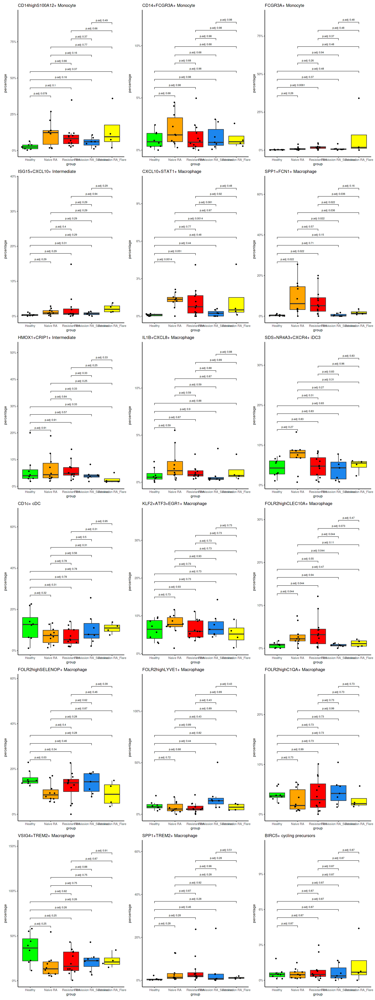

In [32]:
library(pochi)
options(repr.plot.width=15, repr.plot.height=40)
AbundancePlot(myeloid.coi, group.by = "clusters", split.by = "group", 
              replicate.by = "Donor", 
              fill_colors=c("green", "orange","red", "dodgerblue2","yellow")) 

# Visualize UMAP across conditions

In [55]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(myeloid@meta.data),Embeddings(myeloid, reduction = "umap")[,1], Embeddings(myeloid, reduction = "umap")[,2],
                   myeloid$Tissue,myeloid$group,myeloid$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
umap$color_col <- as.ordered(factor(umap$color_col, levels=levels(myeloid$clusters)))
levels(umap$color_col)
umap <- umap[order(umap$ID),]

[1] "CD14highS100A12+ Monocyte"    "CD14+FCGR3A+ Monocyte"       
 [3] "FCGR3A+ Monocyte"             "ISG15+CXCL10+ Intermediate"  
 [5] "CXCL10+STAT1+ Macrophage"     "SPP1+FCN1+ Macrophage"       
 [7] "HMOX1+CRIP1+ Intermediate"    "IL1B+CXCL8+ Macrophage"      
 [9] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[11] "KLF2+ATF3+EGR1+ Macrophage"   "FOLR2highCLEC10A+ Macrophage"
[13] "FOLR2highSELENOP+ Macrophage" "FOLR2highLYVE1+ Macrophage"  
[15] "FOLR2highC1QA+ Macrophage"    "VSIG4+TREM2+ Macrophage"     
[17] "SPP1+TREM2+ Macrophage"       "BIRC5+ cycling precursors"

In [56]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15)) + theme(strip.background = element_rect(colour = "black", fill = "white"),strip.text = element_text(size = 20, color="black"))

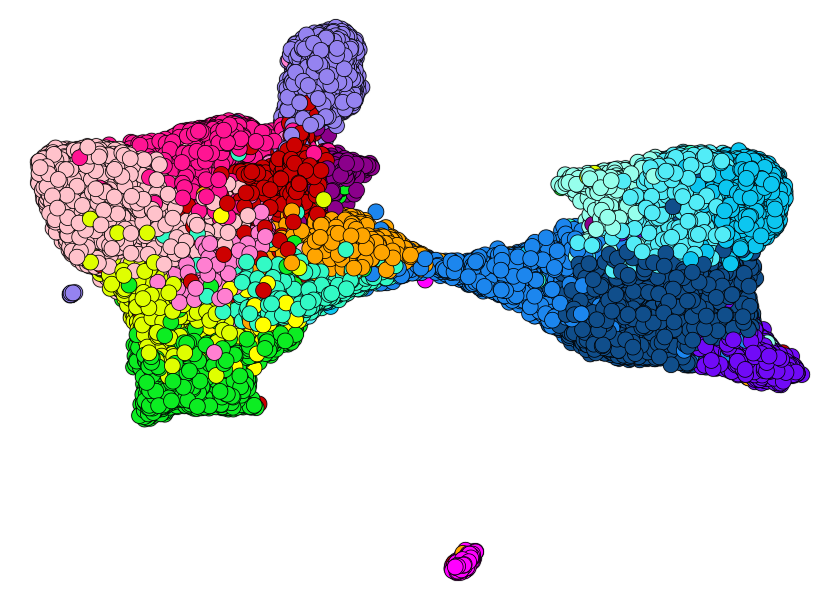

In [58]:
options(repr.plot.width=7, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=4, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=4, shape=21, stroke = 1/4) + 
  scale_fill_manual(name=NULL, labels = levels(umap$color_col), guide="legend", values=cols) + theme_void() + guides(fill=FALSE) 

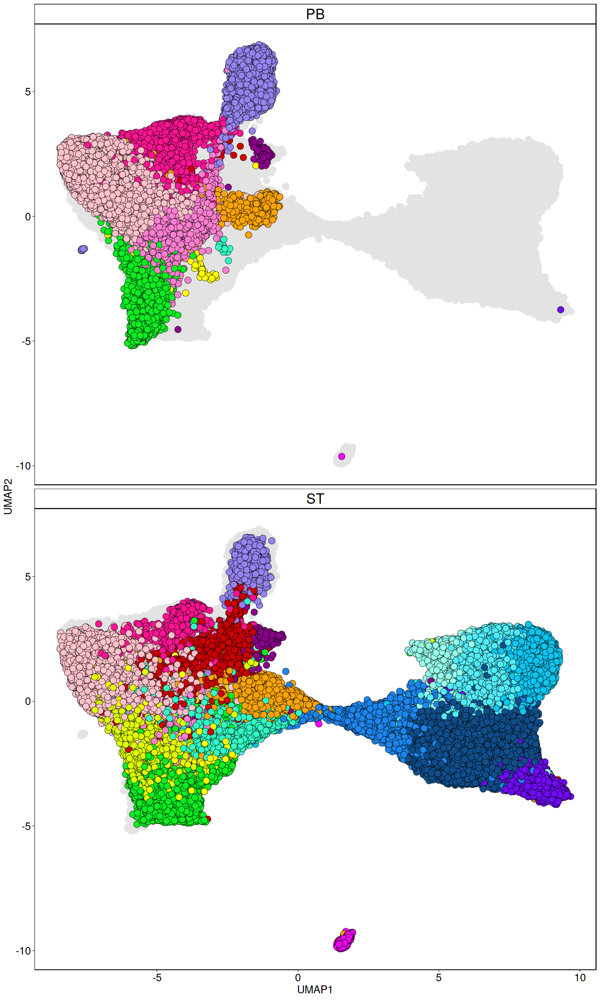

In [147]:
options(repr.plot.width=12, repr.plot.height=20)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=4, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=4, shape=21, stroke = 1/4) + facet_wrap(~facet_col, ncol=1) +
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

In [148]:
#Synovial tissue only 
umap <- data.frame(rownames(myeloid.coi@meta.data),Embeddings(myeloid.coi, reduction = "umap")[,1], Embeddings(myeloid.coi, reduction = "umap")[,2],
                   myeloid.coi$Tissue,myeloid.coi$group,myeloid.coi$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
umap$color_col <- as.ordered(factor(umap$color_col, levels=levels(myeloid.coi$clusters)))
levels(umap$color_col)
umap <- umap[order(umap$ID),]

[1] "CD14highS100A12+ Monocyte"    "CD14+FCGR3A+ Monocyte"       
 [3] "FCGR3A+ Monocyte"             "ISG15+CXCL10+ Intermediate"  
 [5] "CXCL10+STAT1+ Macrophage"     "SPP1+FCN1+ Macrophage"       
 [7] "HMOX1+CRIP1+ Intermediate"    "IL1B+CXCL8+ Macrophage"      
 [9] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[11] "KLF2+ATF3+EGR1+ Macrophage"   "FOLR2highCLEC10A+ Macrophage"
[13] "FOLR2highSELENOP+ Macrophage" "FOLR2highLYVE1+ Macrophage"  
[15] "FOLR2highC1QA+ Macrophage"    "VSIG4+TREM2+ Macrophage"     
[17] "SPP1+TREM2+ Macrophage"       "BIRC5+ cycling precursors"

In [149]:
#Set seed for reproducibility
set.seed(89)
#Downsample for equal comparison between conditions
numcells <- min(sapply(c(as.character(unique(umap$Group))), function(x) length(rownames(umap[umap$Group==x,]))))
downsampled <-  as.vector(sapply(c(as.character(unique(umap$Group))), function(x) sample(rownames(umap[umap$Group==x,]), 
                                                                                         size=numcells, replace=F, prob=NULL )))
labels <- levels(umap$Cluster)
              

In [150]:
downsampledumap <- umap[downsampled,]
downsampledumap <- downsampledumap[order(downsampledumap$color_col),]

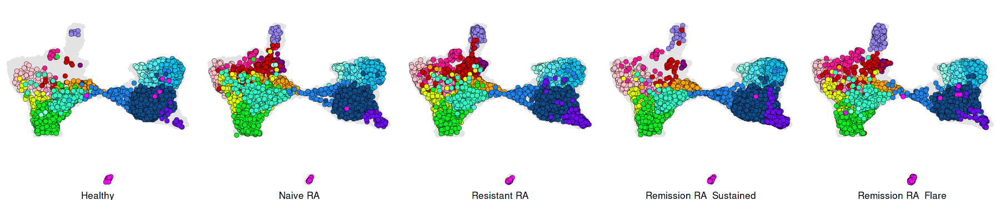

In [151]:
options(repr.plot.width=15, repr.plot.height=3)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=1.5, shape=21) +
  geom_point(data=downsampledumap, aes(fill=factor(color_col)),color="black", size=2, shape=21, stroke = 1/6) + facet_grid(~Group, switch="x") + 
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) + theme_void() + ggtitle("") + guides(fill=FALSE) + theme(strip.text=element_text(size=10))

# Visualize bone marrow transplant data 

In [25]:
bmt <- subset(myeloid.st, subset = group == "Arthralgia")

In [42]:
bmt$snps.ident <- ifelse(bmt$snps.ident=="Donor", "Donor", "Recipient")

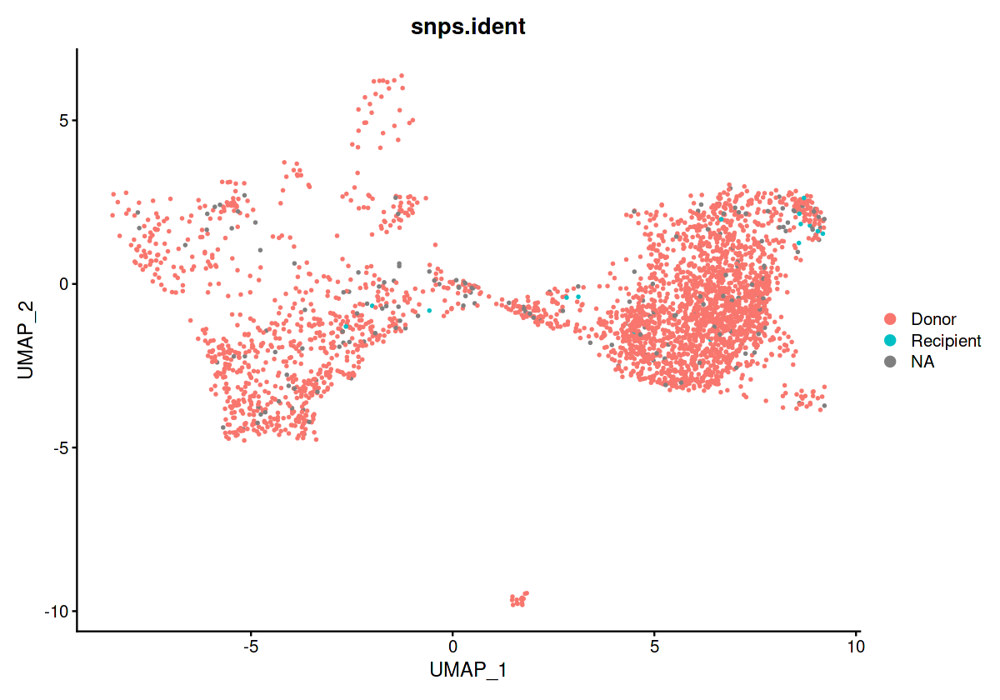

In [53]:
DimPlot(bmt, group.by="snps.ident")

In [46]:
unique(bmt$snps.ident)

[1] NA          "Donor"     "Recipient"

In [68]:
#Create data frame for information required to plot 
bmt.umap <- data.frame(rownames(bmt@meta.data),Embeddings(bmt, reduction = "umap")[,1], Embeddings(bmt, reduction = "umap")[,2],
                   bmt$snps.ident,bmt$snps.ident,bmt$clusters)
colnames(bmt.umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(bmt.umap$UMAP1,bmt.umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
bmt.umap$color_col <- as.ordered(factor(bmt.umap$color_col, levels=levels(myeloid$clusters)))
levels(bmt.umap$color_col)
bmt.umap <- bmt.umap[order(bmt.umap$ID),]

[1] "CD14highS100A12+ Monocyte"    "CD14+FCGR3A+ Monocyte"       
 [3] "FCGR3A+ Monocyte"             "ISG15+CXCL10+ Intermediate"  
 [5] "CXCL10+STAT1+ Macrophage"     "SPP1+FCN1+ Macrophage"       
 [7] "HMOX1+CRIP1+ Intermediate"    "IL1B+CXCL8+ Macrophage"      
 [9] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[11] "KLF2+ATF3+EGR1+ Macrophage"   "FOLR2highCLEC10A+ Macrophage"
[13] "FOLR2highSELENOP+ Macrophage" "FOLR2highLYVE1+ Macrophage"  
[15] "FOLR2highC1QA+ Macrophage"    "VSIG4+TREM2+ Macrophage"     
[17] "SPP1+TREM2+ Macrophage"       "BIRC5+ cycling precursors"

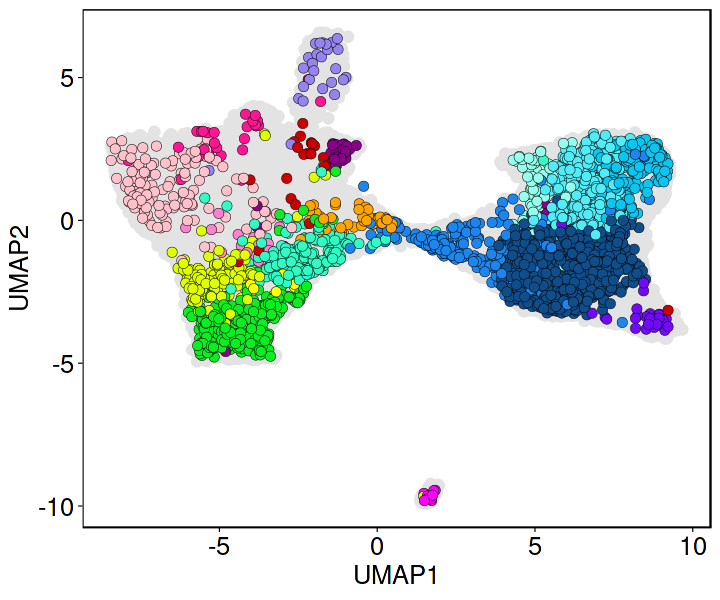

In [73]:
options(repr.plot.width=6, repr.plot.height=5)
ggplot(bmt.umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=umap, colour="grey89", fill="grey89", size=2.5, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=2.5, shape=21, stroke = 1/6) + 
  scale_fill_manual(name=NULL, labels = levels(umap$color_col), guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

[1] "Donor"     "Recipient"

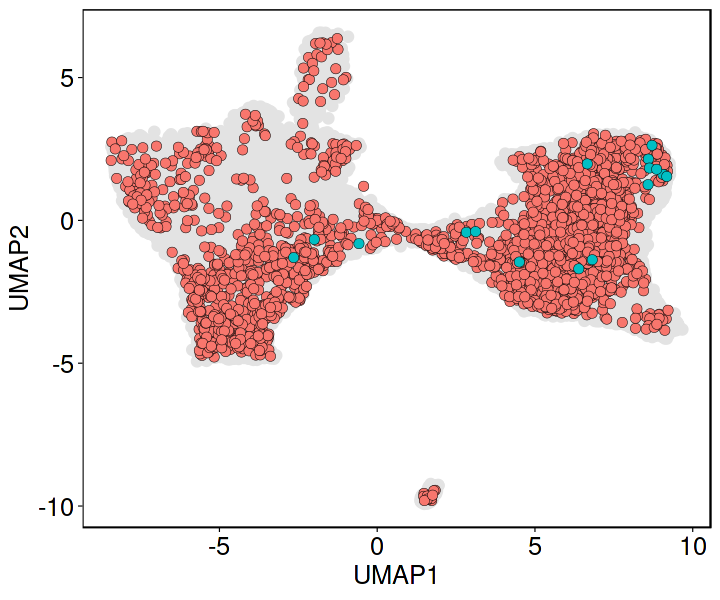

In [77]:
library(scales)
bmt.umap$Group <- as.ordered(factor(bmt.umap$Group, levels=c("Donor","Recipient")))
levels(bmt.umap$Group)
bmt.umap <- bmt.umap[complete.cases(bmt.umap$Group),]
bmt.umap <- bmt.umap[order(bmt.umap$Group),]
options(repr.plot.width=6, repr.plot.height=5)
ggplot() + 
  geom_point(data=umap, aes(x=UMAP1, y=UMAP2), colour="grey89", fill="grey89", size=2.5, shape=21) +
  geom_point(data=bmt.umap, aes(x=UMAP1, y=UMAP2, fill=Group),color="black", size=2.5, shape=21, stroke = 1/6) +
    scale_fill_manual(name=NULL, labels = levels(umap$Group), guide="legend", values=hue_pal()(2)) + theme_specific + guides(fill=FALSE) 

# Find marker genes of named clusters and plot heatmap

In [152]:
cluster.markers <- FindAllMarkers(myeloid, only.pos=TRUE,  min.pct=0.4, test.use="MAST")
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]
myeloid@misc <- cluster.markers

Calculating cluster CD14highS100A12+ Monocyte


 Completed [--------------------------------------------]   0% with 0 failures

 Completed [--------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 fa


 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [===========================


 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>


 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>-----------

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [--------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>------


 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [===========================


 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>---


 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>----------------


 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [=========================================>--]  97% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================


 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [===========================


 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>------


 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>----------------


 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [--------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------


 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [===========================


 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===========================


 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>-----


 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [===========================


 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>--------------

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>-----


 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [===========================


 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [===========================


 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>-----


 Completed [========>-----------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>--------------


 Completed [==========================================>-]  98% with 0 failures

 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------


 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [==================================>---------]  81% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [===========================


 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [===================>------------------------]  47% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  50% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>---


 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>-----------


 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>---------------------


 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [=======================================>----]  91% with 0 failures

 Completed [=======================================>----]  92% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [===========================


 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===========================


 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [===================>------------------------]  47% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [====================>-----------------------]  49% with 0 failures

 Completed [=====================>-----


 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  18% with 0 failures

 Completed [=======>------------------------------------]  19% with 0 failures

 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>---------------


 Completed [==========================================>-]  99% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [===========================================>] 100% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------


 Completed [=================================>----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [===========================


 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>------


 Completed [========>-----------------------------------]  20% with 0 failures

 Completed [========>-----------------------------------]  21% with 0 failures

 Completed [========>-----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  22% with 0 failures

 Completed [=========>----------------------------------]  23% with 0 failures

 Completed [=========>----------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>--------------


 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [--------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------


 Completed [==================================>---------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  81% with 0 failures

 Completed [===================================>--------]  82% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [===========================


 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [===========================


 Completed [============>-------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>----------


 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [=====>--------------------------------------]  15% with 0 failures

 Completed [======>--------------------


 Completed [===================================>--------]  83% with 0 failures

 Completed [====================================>-------]  83% with 0 failures

 Completed [====================================>-------]  84% with 0 failures

 Completed [====================================>-------]  85% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [=====================================>------]  86% with 0 failures

 Completed [=====================================>------]  87% with 0 failures

 Completed [=====================================>------]  88% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [======================================>-----]  89% with 0 failures

 Completed [======================================>-----]  90% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [===========================


 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================

In [153]:
library(data.table)
# pick signficant genes to show in the heatmap
# arrange the genes such that the gene with max logFC is at the center and values decrease as we move away from center
genes_use_df<-data.table(cluster.markers)[
    p_val_adj < 0.05][
    , .SD[order(-avg_log2FC)][1:20, ], by = cluster][
    , .SD[!is.na(gene)]][
    , .SD[order(avg_log2FC)], by = cluster][
    , ":=" (len = .N, rank = frank(avg_log2FC)), by = cluster][
    , .SD[c(seq(1, round(.SD$len[1]/3), 1), seq(.SD$len[1], round(.SD$len[1]/3)+1, -1)), ], by = cluster][
    , .(gene, avg_log2FC, cluster, p_val_adj) 
]
#Organise genes we want to include by cluster
genes_use_df <- genes_use_df %>% distinct(gene, .keep_all = TRUE) %>% arrange(cluster)


Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last




In [154]:
message("Checking that the genes are unique: ", nrow(genes_use_df) == length(unique(genes_use_df$gene)))
message("Number of genes in heatmap: ", nrow(genes_use_df))

 

# select the top 5 genes with highest logFC in each cluster and assign each gene to a cell type based on it logFC - the gene belongs to the celltype with higher logFC
genes_to_mark_celltypes<-genes_use_df[, .SD[order(-avg_log2FC)][1:5, ], by = cluster][
    , .(cluster, gene)
]

 

.mat<-cluster.markers %>% 
    subset(gene %in% genes_use_df$gene) %>% 
    dplyr::select(cluster, avg_log2FC, gene) %>% 
    tidyr::spread(cluster, avg_log2FC) %>% 
    tibble::column_to_rownames('gene') %>% 
    as.matrix() %>% t() 
.mat<-.mat[, genes_use_df$gene]
.mat[is.na(.mat)] <- 0

message(
    "Are all genes that are being marked also present in the matrix?: ", 
    length(setdiff(genes_to_mark_celltypes$gene, colnames(.mat))) == 0
)

 

genes_idx<-data.frame(idx = which(colnames(.mat) %in% genes_to_mark_celltypes$gene)) %>% 
    mutate(gene = colnames(.mat)[idx])

Checking that the genes are unique: TRUE

Number of genes in heatmap: 260

Are all genes that are being marked also present in the matrix?: TRUE



In [155]:
#Get the exact position of genes we wish to annotate in the matrix
genes_to_mark_celltypes<-genes_to_mark_celltypes %>% left_join(unique(genes_idx), by = "gene")

genes_to_mark_celltypes %>% arrange(cluster)

cluster,gene,idx
<fct>,<chr>,<int>
CD14highS100A12+ Monocyte,S100A12,8
CD14highS100A12+ Monocyte,S100A9,9
CD14highS100A12+ Monocyte,S100A8,10
CD14highS100A12+ Monocyte,VCAN,11
CD14highS100A12+ Monocyte,FCN1,12
CD14+FCGR3A+ Monocyte,TXNIP,27
CD14+FCGR3A+ Monocyte,ITGA4,28
CD14+FCGR3A+ Monocyte,LGALS2,29
CD14+FCGR3A+ Monocyte,LCP1,30


In [156]:
library(ComplexHeatmap)
options(repr.plot.width=15, repr.plot.height=5)

gene.anno<-columnAnnotation(
    col_ann = anno_mark(
        at = genes_to_mark_celltypes$idx,
        side = "bottom",
        labels = genes_to_mark_celltypes$gene)
    )

clust.anno<-columnAnnotation(show_legend = TRUE,
    cluster = genes_use_df$cluster,
    col = list(cluster=cols))

 #ha2<-columnAnnotation(
#     celltypes = anno_block(
#         gp = gpar(fill = col_pal), 
#         labels = genes_use_df$contrast %>% unique

 

# ))
anno_mark(
        at = genes_to_mark_celltypes$idx,
        side = "bottom",
        labels = genes_to_mark_celltypes$gene)


Loading required package: grid

ComplexHeatmap version 2.15.4
Bioconductor page: http://bioconductor.org/packages/ComplexHeatmap/
Github page: https://github.com/jokergoo/ComplexHeatmap
Documentation: http://jokergoo.github.io/ComplexHeatmap-reference

If you use it in published research, please cite either one:
- Gu, Z. Complex Heatmap Visualization. iMeta 2022.
- Gu, Z. Complex heatmaps reveal patterns and correlations in multidimensional 
    genomic data. Bioinformatics 2016.


The new InteractiveComplexHeatmap package can directly export static 
complex heatmaps into an interactive Shiny app with zero effort. Have a try!

This message can be suppressed by:
  suppressPackageStartupMessages(library(ComplexHeatmap))
! pheatmap() has been masked by ComplexHeatmap::pheatmap(). Most of the arguments
   in the original pheatmap() are identically supported in the new function. You 
   can still use the original function by explicitly calling pheatmap::pheatmap().



Attaching package: ‘Co

An AnnotationFunction object
  function: anno_mark()
  position: column 
  items: -1 
  width: 1npc 
  height: 28.9888888888889mm 
  imported variable: .pos, labels_gp, extend, side, at2index, labels_rot, at, link_height, link_width, link_gp, at2labels, .scale, padding 
  subsettable variable: at 
  this object is subsettable

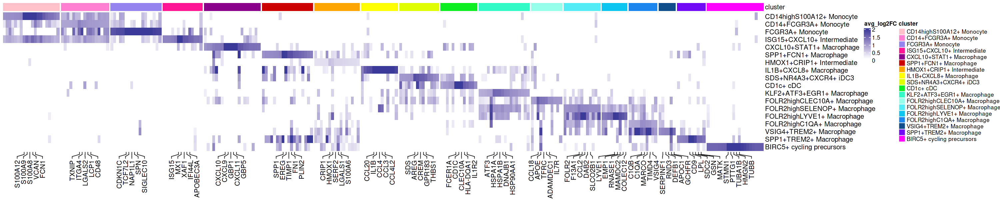

In [157]:
library(scales)
split<-genes_use_df$cluster
options(repr.plot.width=25, repr.plot.height=5)
colnames(.mat)<-NULL
.mat %>% 
    Heatmap(
        name = 'avg_log2FC',
        col = circlize::colorRamp2(c(0, 0.1, 2), c('white', 'white', muted('blue'))),
        #column_names_gp = grid::gpar(fontsize = 10),
#         row_dend_side = "right",
        cluster_rows = FALSE,
        cluster_columns = FALSE,
        top_annotation = clust.anno,
        column_title=NULL,
        bottom_annotation = gene.anno,
        column_split = split,
    )


In [158]:
write.csv(cluster.markers, "myeloid_pb_st_cluster.markers.csv")

In [50]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15))

In [34]:
genes <- c("VSIG4","TNFRSF1A","TNFRSF1B")

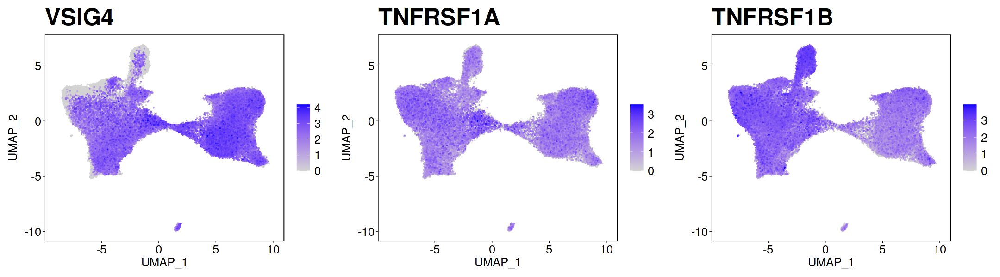

In [35]:
options(repr.plot.width=18, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(myeloid, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=3)


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


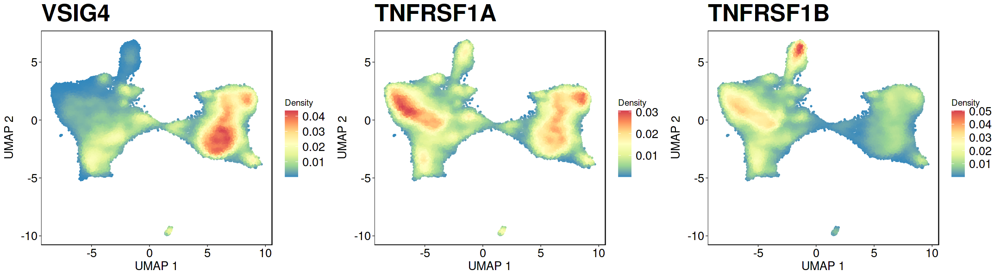

In [38]:
options(repr.plot.width=18, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(myeloid,gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15)) + scale_color_distiller(palette = "Spectral")  }

plot_grid(plotlist=x, ncol=3)

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


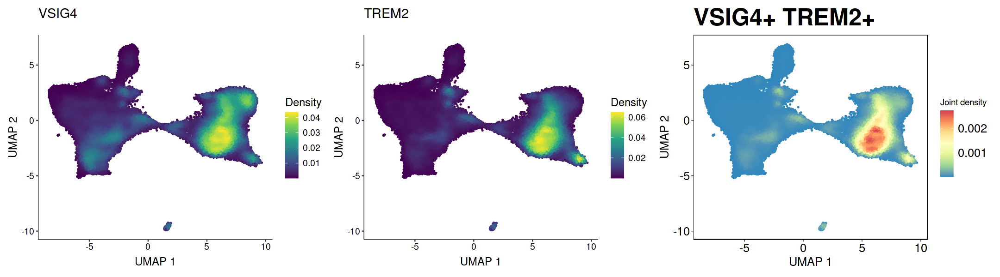

In [36]:
options(repr.plot.width=18, repr.plot.height=5)
plot_density(myeloid,c("VSIG4","TREM2"), joint=TRUE, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15)) + scale_color_distiller(palette = "Spectral")  


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


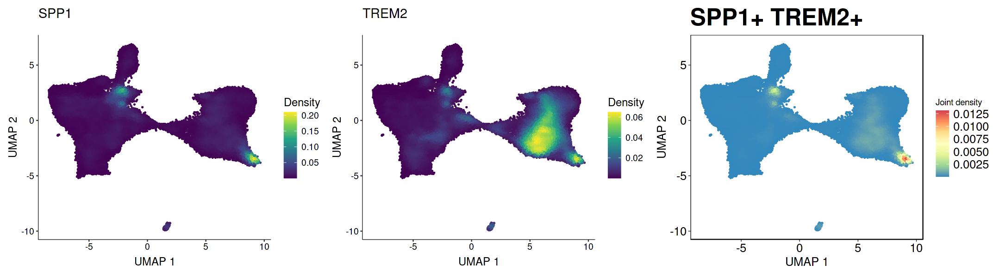

In [37]:
options(repr.plot.width=18, repr.plot.height=5)
plot_density(myeloid,c("SPP1","TREM2"), joint=TRUE, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15)) + scale_color_distiller(palette = "Spectral")  


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


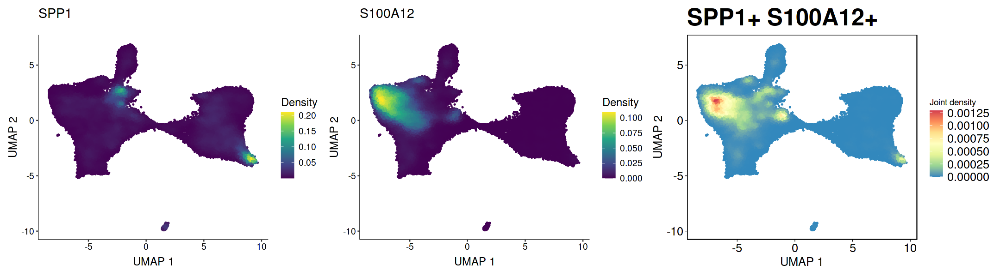

In [479]:
options(repr.plot.width=18, repr.plot.height=5)
plot_density(myeloid,c("SPP1","S100A12"), joint=TRUE, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15)) + scale_color_distiller(palette = "Spectral")  


In [11]:
genes <- c("VSIG4","TREM2","BIRC5")

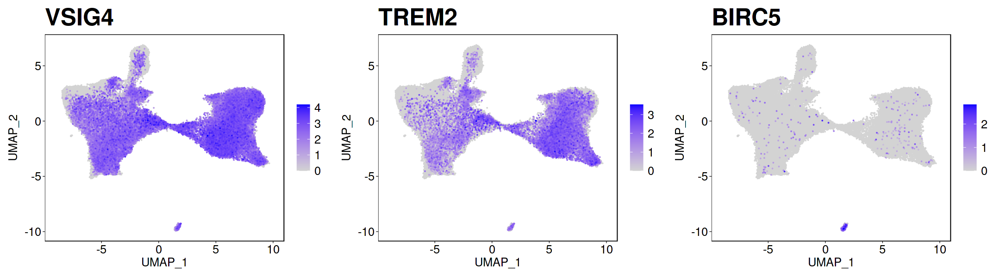

In [15]:
options(repr.plot.width=18, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(myeloid, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=3)


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


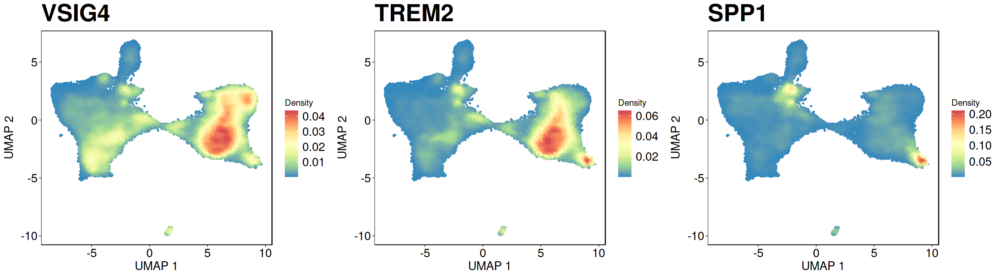

In [80]:
options(repr.plot.width=18, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(myeloid,gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15)) + scale_color_distiller(palette = "Spectral")  }

plot_grid(plotlist=x, ncol=3)


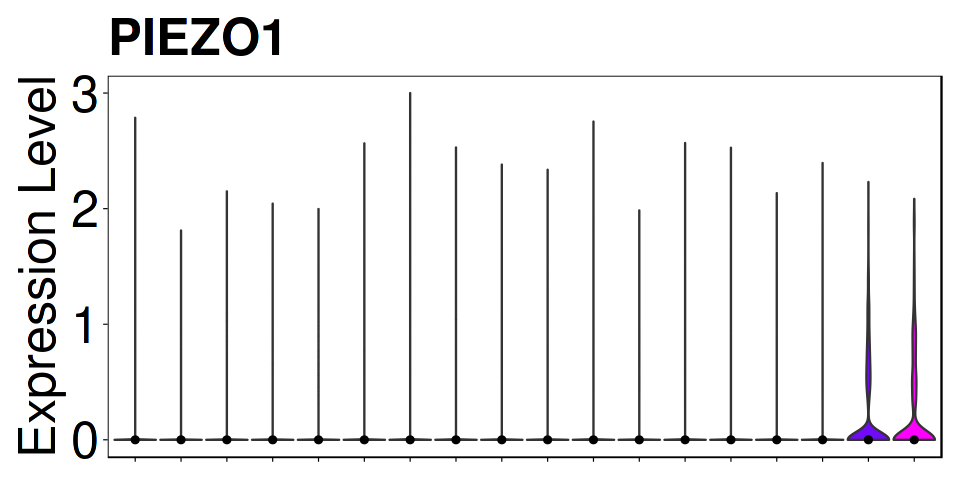

In [61]:
options(repr.plot.width=8, repr.plot.height=4)
Idents(myeloid.coi) <- "clusters"
VlnPlot(myeloid.coi, features="PIEZO1", pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) + NoLegend()#+ geom_hline(yintercept=median, linetype="dashed", size=2, color = "black")
Idents(myeloid.coi) <- "clusters"

In [545]:
#Rename your clusters by celltype
Idents(myeloid.st) <- "clusters"
unique(Idents(myeloid.st))

[1] FOLR2highSELENOP+ Macrophage     HMOX1+C1QA+ Macrophage          
 [3] VSIG4+TREM2+ Macrophage          FOLR2highLYVE1+PMP22+ Macrophage
 [5] SDS+CREM+NR4A3+CXCR4+ iDC3       SPP1+TREM2+ Macrophage          
 [7] FOLR2highLYVE1+ Macrophage       FOLR2highCLEC10A+ Macrophage    
 [9] CD1c+ DC2/3                      BIRC5+ cycling precursors       
[11] IL1B+CXCL8+ Macrophage           ISG15+CXCL10+ Intermediate      
[13] CD14+FCGR3A+ Monocyte            CD14highS100A12+ Monocyte       
[15] FCGR3A+ Monocyte                 S100A12+TIMP1+SPP1+ Macrophage  
[17] CXCL10+STAT1+ Macrophage         SPP1+FCN1+ Macrophage           
18 Levels: CD14highS100A12+ Monocyte CD14+FCGR3A+ Monocyte ... CD1c+ DC2/3

In [23]:
VSIG4pos <- subset(myeloid.coi, idents="VSIG4+TREM2+ Macrophage")
Idents(VSIG4pos) <- "group"

TREM2low <- subset(myeloid.coi, idents="SPP1+TREM2+ Macrophage")
Idents(TREM2low) <- "group"

BIRC5pos <- subset(myeloid.coi, idents="BIRC5+ cycling precursors")
Idents(BIRC5pos) <- "group"

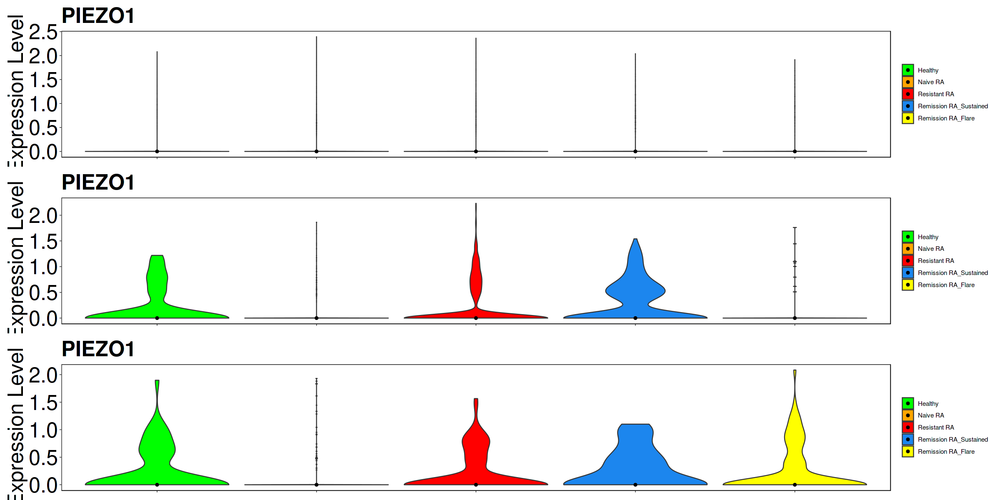

In [49]:
options(epr.plot.width=15, repr.plot.height=10)
group.cols <- c("green", "orange","red", "dodgerblue2","yellow")
x <- list()
for(gene in c("PIEZO1")){
    x[[paste0(gene,"1")]] <- VlnPlot(VSIG4pos, features=gene, pt.size=0,ncol=1, cols=group.cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) #+ geom_hline(yintercept=median, linetype="dashed", size=2, color = "black")
     x[[paste0(gene,"2")]] <- VlnPlot(TREM2low, features=gene, pt.size=0,ncol=1, cols=group.cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) #_hline(yintercept=median, linetype="dashed", size=2, color = "black")
    x[[paste0(gene,"3")]] <- VlnPlot(BIRC5pos, features=gene, pt.size=0,ncol=1, cols=group.cols) + stat_summary(fun = "median",                                                                                                                                  
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) #+ geom_hline(yintercept=median, linetype="dashed", size=2, color = "black")
    
}
plot_grid(plotlist=x, ncol=1)

In [578]:
saveRDS(myeloid, "renamed.myeloid.rds")

In [50]:
myeloid.coi$cluster_group <- paste0(myeloid.coi$clusters, "_", myeloid.coi$group)

In [67]:
unique(myeloid.coi$group)

[1] Healthy                Naive RA               Remission RA_Sustained
[4] Remission RA_Flare     Resistant RA          
5 Levels: Healthy Naive RA Resistant RA ... Remission RA_Flare

In [79]:
myeloid.coi.avg <- AverageExpression(myeloid.coi, group.by = "cluster_group", return.seurat=TRUE)

Centering and scaling data matrix



In [104]:
#Fetch expression of genes 
matrix <- FetchData(myeloid.coi.avg, vars=c("PIEZO1","PIEZO2"), slot="data")
data <- t(matrix)

#Reposition the breaks at the quantiles of the data, then each color will represent an equal proportion of the data:
mat_breaks <- seq(min(data), max(data), length.out = 10)
quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs, probs = seq(0, 1, length.out = n))
  breaks[!duplicated(breaks)]
}
mat_breaks <- quantile_breaks(data, n = 11)

In [105]:
myeloid.coi.avg$clusters <- Idents(myeloid.coi.avg)

In [106]:
myeloid.coi.avg$group <- sub('.*_', '', Cells(myeloid.coi.avg))
unique(myeloid.coi.avg$group)
myeloid.coi.avg$group <- as.ordered(factor(myeloid.coi.avg$group, levels=c('Healthy','Naive RA','Resistant RA','Sustained','Flare')))
myeloid.coi.avg$clusters <- as.ordered(factor(myeloid.coi.avg$clusters, levels=levels(myeloid.coi$clusters)))

[1] "Healthy"      "Naive RA"     "Flare"        "Sustained"    "Resistant RA"

In [107]:
#Fetch metadata
annotation_col <- as.data.frame(myeloid.coi.avg@meta.data %>% select(clusters, group))
annotation_col$group <- as.ordered(factor(annotation_col$group, levels=c('Healthy','Naive RA','Resistant RA','Sustained','Flare')))
annotation_col$clusters <- as.ordered(factor(annotation_col$clusters, levels=levels(myeloid.coi$clusters)))
#Set up colour scheme
names(group.cols) <- levels(myeloid.coi.avg$group)
metacols <- list(
  clusters = cols, 
    group = group.cols
)
#Order cells by cluster
data <- data[,order(annotation_col$cluster, annotation_col$group)]

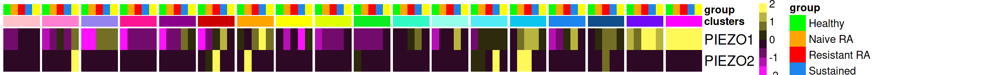

In [110]:
options(repr.plot.width=20, repr.plot.height=1.5)
#Scale data
scale_rows <- function(x) t(scale(t(x)))
data <- scale_rows(data) # Z-score
data[data > 2] <- 2
data[data < -2] <- -2

#Generate heatmap
pheatmap(
  mat = data,
  border_color = NA,
  color = colorRampPalette(c("#FE11FF","#0B0801","#FFF957"))(8),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = FALSE,
  cluster_cols = FALSE,
   annotation_col = annotation_col, annotation_colors = metacols, #annotation_row=annotation_row,
  fontsize = 15,
  fontsize_row = 20,
  scale = "none", gaps_col=head(as.numeric(cumsum(table(annotation_col$cluster))), -1)
)

# Transcription factor activity inference 

In [81]:
net <- decoupleR::get_collectri(organism = 'human', 
                                split_complexes = FALSE)

net

source,target,mor
<chr>,<chr>,<dbl>
MYC,TERT,1
SPI1,BGLAP,1
SMAD3,JUN,1
SMAD4,JUN,1
STAT5A,IL2,1
STAT5B,IL2,1
RELA,FAS,1
WT1,NR0B1,1
NR0B2,CASP1,1


In [82]:
# Extract the normalized log-transformed counts
mat <- as.matrix(myeloid@assays$RNA@data)

# Run ulm
acts <- decoupleR::run_ulm(mat = mat, 
                           net = net, 
                           .source = 'source', 
                           .target = 'target',
                           .mor='mor', 
                           minsize = 5)

acts

statistic,source,condition,score,p_value
<chr>,<chr>,<chr>,<dbl>,<dbl>
ulm,ABL1,100046_8_5,2.8308218,0.0046486391
ulm,ABL1,100143_8_5,3.8845322,0.0001029392
ulm,ABL1,10027099_4,-0.2243594,0.8224804844
ulm,ABL1,10027796_4,1.5459262,0.1221421462
ulm,ABL1,10027841_1_2,3.6612084,0.0002518356
ulm,ABL1,10027862_1_2,-1.3442450,0.1788882064
ulm,ABL1,10028206_4,3.4316478,0.0006014404
ulm,ABL1,10028957_3_2,2.2379675,0.0252368556
ulm,ABL1,10028981_3_2,3.3229191,0.0008928025


In [83]:
# Extract TF activity data and store it as new assay
myeloid[['TFA']] <- acts %>%
                    tidyr::pivot_wider(id_cols = 'source', 
                                       names_from = 'condition',
                                       values_from = 'score') %>%
                    tibble::column_to_rownames('source') %>%
                    Seurat::CreateAssayObject(.)

# Change assay
DefaultAssay(object = myeloid) <- "TFA"

# Scale the data
myeloid <- Seurat::ScaleData(myeloid)
myeloid@assays$TFA@data <- myeloid@assays$TFA@scale.data

Centering and scaling data matrix



In [84]:
n_tfs <- 50

# Extract activities from object as a long dataframe
df <- t(as.matrix(myeloid@assays$TFA@data)) %>%
      as.data.frame() %>%
      dplyr::mutate(cluster = Seurat::Idents(myeloid)) %>%
      tidyr::pivot_longer(cols = -cluster, 
                          names_to = "source", 
                          values_to = "score") %>%
      dplyr::group_by(cluster, source) %>%
      dplyr::summarise(mean = mean(score))


`summarise()` has grouped output by 'cluster'. You can override using the `.groups` argument.


In [85]:

# Get top tfs with more variable means across clusters
tfs <- df %>%
       dplyr::group_by(source) %>%
       dplyr::summarise(std = stats::sd(mean)) %>%
       dplyr::arrange(-abs(std)) %>%
       head(n_tfs) %>%
       dplyr::pull(source)

# Subset long data frame to top tfs and transform to wide matrix
top_acts_mat <- df %>%
                dplyr::filter(source %in% tfs) %>%
                tidyr::pivot_wider(id_cols = 'cluster', 
                                   names_from = 'source',
                                   values_from = 'mean') %>%
                tibble::column_to_rownames('cluster') %>%
                as.matrix()


In [200]:
# Extract activities from object as a long dataframe
birc5.tfs <- t(as.matrix(myeloid@assays$TFA@data)) %>%
      as.data.frame() %>%
      mutate(cluster = myeloid$cluster_group) %>%
      tidyr::pivot_longer(cols = -cluster, 
                          names_to = "source", 
                          values_to = "score") %>% 
      group_by(cluster, source) %>%
      summarise(mean = mean(score)) %>%
     filter(cluster == "BIRC5+ cycling precursors_Healthy") %>% slice_max(n = 50, order_by = mean)
birc5.tfs

`summarise()` has grouped output by 'cluster'. You can override using the `.groups` argument.


cluster,source,mean
<chr>,<chr>,<dbl>
BIRC5+ cycling precursors_Healthy,E2F4,3.5743152
BIRC5+ cycling precursors_Healthy,E2F1,2.2164780
BIRC5+ cycling precursors_Healthy,TFDP1,2.1110971
BIRC5+ cycling precursors_Healthy,PAX9,1.7650516
BIRC5+ cycling precursors_Healthy,LYL1,1.6771332
BIRC5+ cycling precursors_Healthy,NONO,1.5885290
BIRC5+ cycling precursors_Healthy,STOX1,1.4555795
BIRC5+ cycling precursors_Healthy,E2F2,1.4131312
BIRC5+ cycling precursors_Healthy,HCFC1,1.3974687


In [201]:
# Extract activities from object as a long dataframe
df <- t(as.matrix(myeloid@assays$TFA@data)) %>%
      as.data.frame() %>%
      mutate(cluster = Idents(myeloid)) %>%
      tidyr::pivot_longer(cols = -cluster, 
                          names_to = "source", 
                          values_to = "score") %>% 
      group_by(cluster, source) %>%
      summarise(mean = mean(score)) 
# Subset long data frame to top tfs and transform to wide matrix
top_acts_mat <- df %>%
                dplyr::filter(source %in% birc5.tfs$source) %>%
                tidyr::pivot_wider(id_cols = 'cluster', 
                                   names_from = 'source',
                                   values_from = 'mean') %>%
                tibble::column_to_rownames('cluster') %>%
                as.matrix()

`summarise()` has grouped output by 'cluster'. You can override using the `.groups` argument.


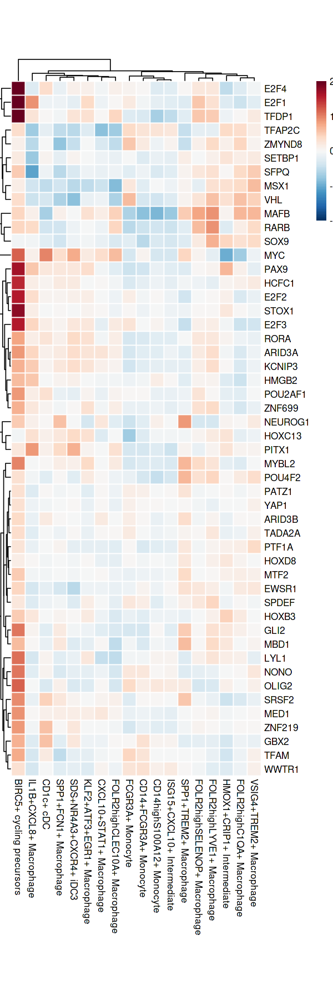

In [202]:
# Choose color palette
colors <- rev(RColorBrewer::brewer.pal(n = 11, name = "RdBu"))
colors.use <- grDevices::colorRampPalette(colors = colors)(100)

my_breaks <- c(seq(-2, 0, length.out = ceiling(100 / 2) + 1),
               seq(0.05, 2, length.out = floor(100 / 2)))

# Plot
options(repr.plot.width=5, repr.plot.height=15)
pheatmap::pheatmap(mat = t(top_acts_mat),
                   color = colors.use,
                   border_color = "white",
                   breaks = my_breaks,
                   cellwidth = 15,
                   cellheight = 15,
                   treeheight_row = 20,
                   treeheight_col = 20) 

In [92]:
# Extract activities from object as a long dataframe
vsig4.tfs <- t(as.matrix(myeloid@assays$TFA@data)) %>%
      as.data.frame() %>%
      mutate(cluster = myeloid$cluster_group) %>%
      tidyr::pivot_longer(cols = -cluster, 
                          names_to = "source", 
                          values_to = "score") %>% 
      group_by(cluster, source) %>%
      summarise(mean = mean(score)) %>%
     filter(cluster == "VSIG4+TREM2+ Macrophage_Healthy") %>% slice_max(n = 50, order_by = mean)
vsig4.tfs

`summarise()` has grouped output by 'cluster'. You can override using the `.groups` argument.


cluster,source,mean
<chr>,<chr>,<dbl>
VSIG4+TREM2+ Macrophage_Healthy,PITX3,1.1782233
VSIG4+TREM2+ Macrophage_Healthy,MSX1,0.9426814
VSIG4+TREM2+ Macrophage_Healthy,RXRB,0.9301700
VSIG4+TREM2+ Macrophage_Healthy,NR2E3,0.9175694
VSIG4+TREM2+ Macrophage_Healthy,FEV,0.8850877
VSIG4+TREM2+ Macrophage_Healthy,TFE3,0.8812234
VSIG4+TREM2+ Macrophage_Healthy,SFPQ,0.8606933
VSIG4+TREM2+ Macrophage_Healthy,MSX2,0.8339390
VSIG4+TREM2+ Macrophage_Healthy,SOX9,0.7052212


In [93]:
# Extract activities from object as a long dataframe
df <- t(as.matrix(myeloid@assays$TFA@data)) %>%
      as.data.frame() %>%
      mutate(cluster = Idents(myeloid)) %>%
      tidyr::pivot_longer(cols = -cluster, 
                          names_to = "source", 
                          values_to = "score") %>% 
      group_by(cluster, source) %>%
      summarise(mean = mean(score)) 
# Subset long data frame to top tfs and transform to wide matrix
top_acts_mat <- df %>%
                dplyr::filter(source %in% vsig4.tfs$source) %>%
                tidyr::pivot_wider(id_cols = 'cluster', 
                                   names_from = 'source',
                                   values_from = 'mean') %>%
                tibble::column_to_rownames('cluster') %>%
                as.matrix()

`summarise()` has grouped output by 'cluster'. You can override using the `.groups` argument.


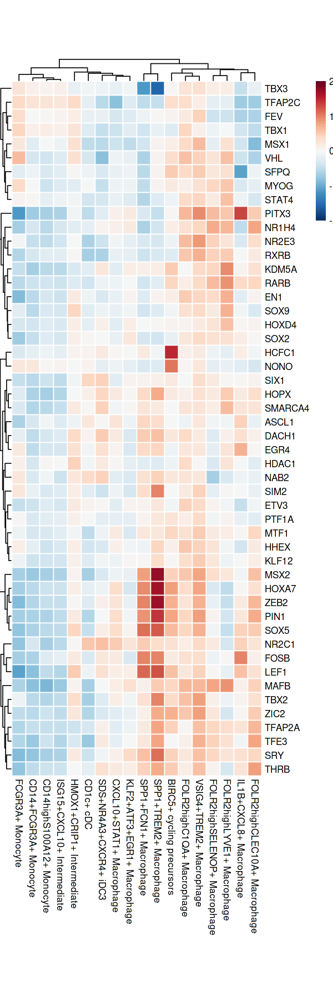

In [94]:
# Choose color palette
colors <- rev(RColorBrewer::brewer.pal(n = 11, name = "RdBu"))
colors.use <- grDevices::colorRampPalette(colors = colors)(100)

my_breaks <- c(seq(-2, 0, length.out = ceiling(100 / 2) + 1),
               seq(0.05, 2, length.out = floor(100 / 2)))

# Plot
options(repr.plot.width=5, repr.plot.height=15)
pheatmap::pheatmap(mat = t(top_acts_mat),
                   color = colors.use,
                   border_color = "white",
                   breaks = my_breaks,
                   cellwidth = 15,
                   cellheight = 15,
                   treeheight_row = 20,
                   treeheight_col = 20) 

In [168]:
# Extract activities from object as a long dataframe
df <- t(as.matrix(myeloid@assays$TFA@data)) %>%
      as.data.frame() %>%
      mutate(cluster = Idents(myeloid)) %>%
      tidyr::pivot_longer(cols = -cluster, 
                          names_to = "source", 
                          values_to = "score") %>% 
      group_by(cluster, source) %>%
      summarise(mean = mean(score)) 
# Subset long data frame to top tfs and transform to wide matrix
top_acts_mat <- df %>%
                dplyr::filter(source %in% c("NR1H2","NR1H3","RXRA","RXRB",
                                           "PPARG")) %>%
                tidyr::pivot_wider(id_cols = 'cluster', 
                                   names_from = 'source',
                                   values_from = 'mean') %>%
                tibble::column_to_rownames('cluster') %>%
                as.matrix()

`summarise()` has grouped output by 'cluster'. You can override using the `.groups` argument.


In [186]:
#Fetch metadata
annotation_col <- as.data.frame(unique(myeloid$clusters))
colnames(annotation_col) <- "clusters"
annotation_col$clusters <- as.ordered(factor(annotation_col$clusters, levels=levels(myeloid$clusters)))
rownames(annotation_col) <- annotation_col$clusters
#Set up colour scheme
metacols <- list(
  clusters = cols
)

In [172]:
head(t(top_acts_mat))

,CD14highS100A12+ Monocyte,CD14+FCGR3A+ Monocyte,FCGR3A+ Monocyte,ISG15+CXCL10+ Intermediate,CXCL10+STAT1+ Macrophage,SPP1+FCN1+ Macrophage,HMOX1+CRIP1+ Intermediate,IL1B+CXCL8+ Macrophage,SDS+NR4A3+CXCR4+ iDC3,CD1c+ cDC,KLF2+ATF3+EGR1+ Macrophage,FOLR2highCLEC10A+ Macrophage,FOLR2highSELENOP+ Macrophage,FOLR2highLYVE1+ Macrophage,FOLR2highC1QA+ Macrophage,VSIG4+TREM2+ Macrophage,SPP1+TREM2+ Macrophage,BIRC5+ cycling precursors
NR1H2,-0.3666634,-0.3903798,-0.8380912,-0.4263688,-0.28200490,-0.26516672,-0.13446111,-0.12532483,-0.31017701,-0.7007642,0.02005127,0.8394270,0.6064379,0.4672662,0.40878882,0.6557253,0.30331362,0.23488578
NR1H3,-0.4348922,-0.4004660,-1.3203961,-0.4879878,0.04578548,0.08604091,-0.29155477,0.13744004,0.04733964,-0.3557323,0.25609971,1.0505842,0.7246894,0.1975588,0.20057337,0.5311414,0.33270546,0.07637414
PPARG,-0.3533543,-0.5169912,-0.3064404,-0.3737555,-0.02456583,0.24342148,-0.39205353,0.04900055,0.66839337,-0.2918545,0.50235521,0.9721943,0.4491176,0.2470606,-0.33690963,0.1716399,-0.08399984,-0.29103950
RXRA,-0.1597443,-0.5991115,-0.9733573,-0.3052516,-0.01115359,0.02703799,-0.14356454,0.62119241,0.34366486,-0.4326455,0.11235430,0.5952108,0.5910653,0.5016719,-0.01749682,0.2260894,-0.17138970,0.12214525
RXRB,-0.2293220,-0.3594194,-0.5987545,-0.2169969,-0.15094040,-0.43233886,0.01242055,-0.01203913,-0.60342812,-0.6576398,-0.17096774,0.2051819,0.4574392,0.5140797,0.52894088,0.7068072,-0.28344942,-0.25735027


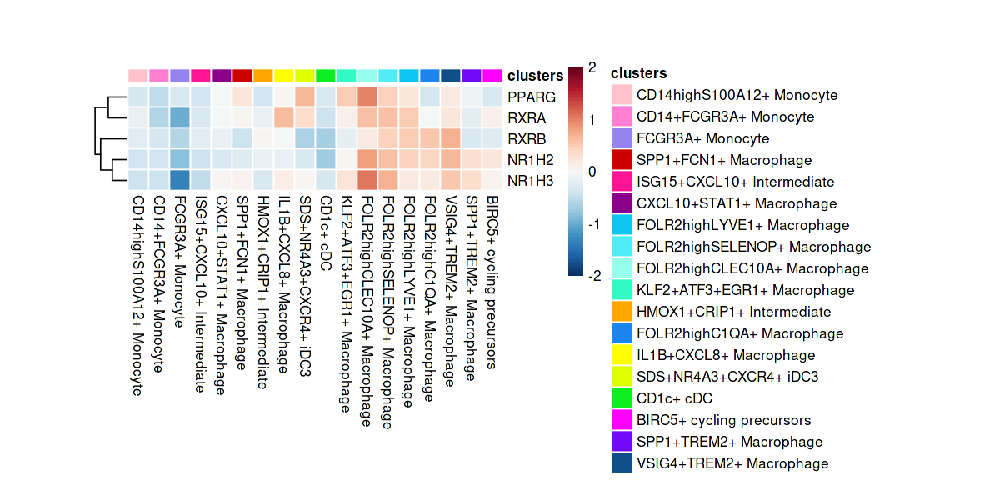

In [188]:
# Choose color palette
colors <- rev(RColorBrewer::brewer.pal(n = 11, name = "RdBu"))
colors.use <- grDevices::colorRampPalette(colors = colors)(100)

my_breaks <- c(seq(-2, 0, length.out = ceiling(100 / 2) + 1),
               seq(0.05, 2, length.out = floor(100 / 2)))

# Plot
options(repr.plot.width=10, repr.plot.height=5)
pheatmap::pheatmap(mat = t(top_acts_mat),
                   color = colors.use,
                   border_color = "white",
                   annotation_col = annotation_col, annotation_colors = metacols, #annotation_row=annotation_row,
                   breaks = my_breaks,
                   cellwidth = 15,
                     cluster_cols = FALSE,
                   cellheight = 15,
                   treeheight_row = 20,
                   treeheight_col = 20) 

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


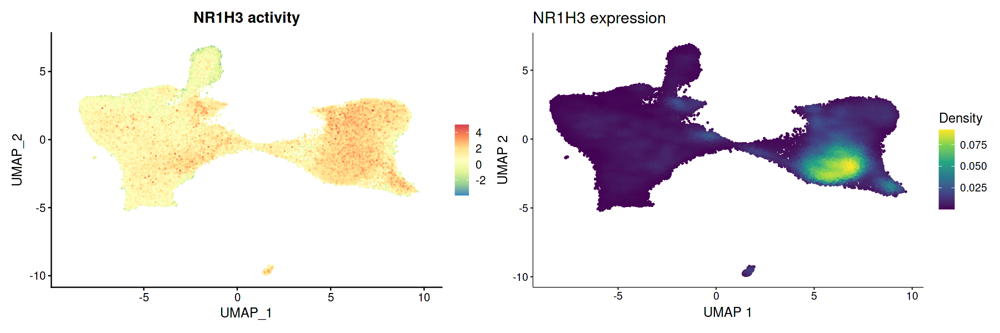

In [39]:
TF <- "NR1H3"

options(repr.plot.width=15, repr.plot.height=5)
DefaultAssay(object=myeloid) <- "TFA"

p1 <- FeaturePlot(myeloid, 
                          features = TF, order=TRUE) + 
      scale_color_distiller(palette = "Spectral")  +
      ggtitle(paste0(TF,' activity'))


DefaultAssay(object=myeloid) <- "RNA"
p2 <- plot_density(myeloid, 
                          features = TF) + 
      ggtitle(paste0(TF,' expression'))

p <- p1 | p2 
p

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


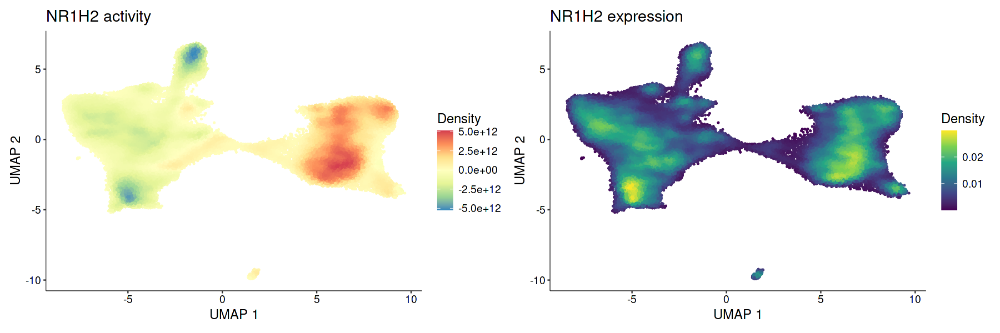

In [165]:
TF <- "NR1H2"

DefaultAssay(object=myeloid) <- "TFA"

p1 <- plot_density(myeloid, 
                          features = TF) + 
      scale_color_distiller(palette = "Spectral")  +
      ggtitle(paste0(TF,' activity'))

DefaultAssay(object=myeloid) <- "RNA"
p2 <- plot_density(myeloid, 
                          features = TF) + 
      ggtitle(paste0(TF,' expression'))

p <- p1 | p2 
p

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


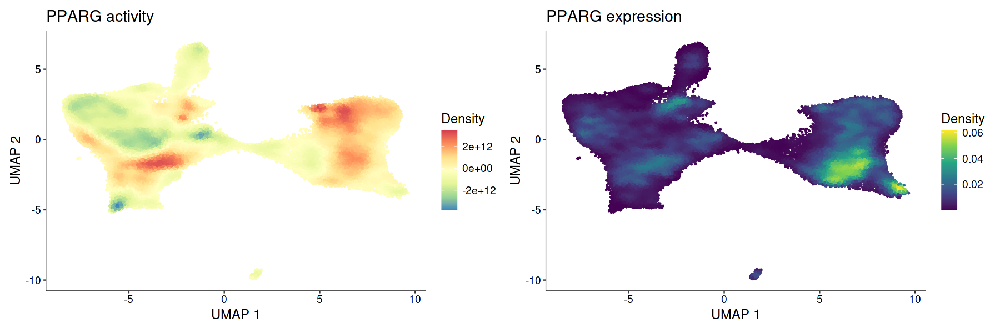

In [166]:
TF <- "PPARG"

DefaultAssay(object=myeloid) <- "TFA"

p1 <- plot_density(myeloid, 
                          features = TF) + 
      scale_color_distiller(palette = "Spectral")  +
      ggtitle(paste0(TF,' activity'))

DefaultAssay(object=myeloid) <- "RNA"
p2 <- plot_density(myeloid, 
                          features = TF) + 
      ggtitle(paste0(TF,' expression'))

p <- p1 | p2 
p

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


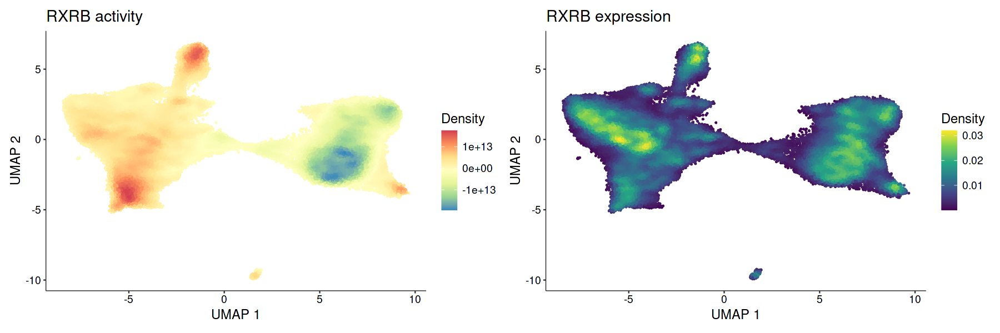

In [167]:
TF <- "RXRB"

DefaultAssay(object=myeloid) <- "TFA"f 

p1 <- plot_density(myeloid, 
                          features = TF) + 
      scale_color_distiller(palette = "Spectral")  +
      ggtitle(paste0(TF,' activity'))

DefaultAssay(object=myeloid) <- "RNA"
p2 <- plot_density(myeloid, 
                          features = TF) + 
      ggtitle(paste0(TF,' expression'))

p <- p1 | p2 
p

# Cell cycle regression

In [107]:
s.genes <- cc.genes$s.genes
g2m.genes <- cc.genes$g2m.genes


In [108]:
cyling.myeloid <- CellCycleScoring(myeloid, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)


In [109]:
cyling.myeloid$Phase <- as.ordered(factor(cyling.myeloid$Phase, levels=c("G1","S","G2M")))

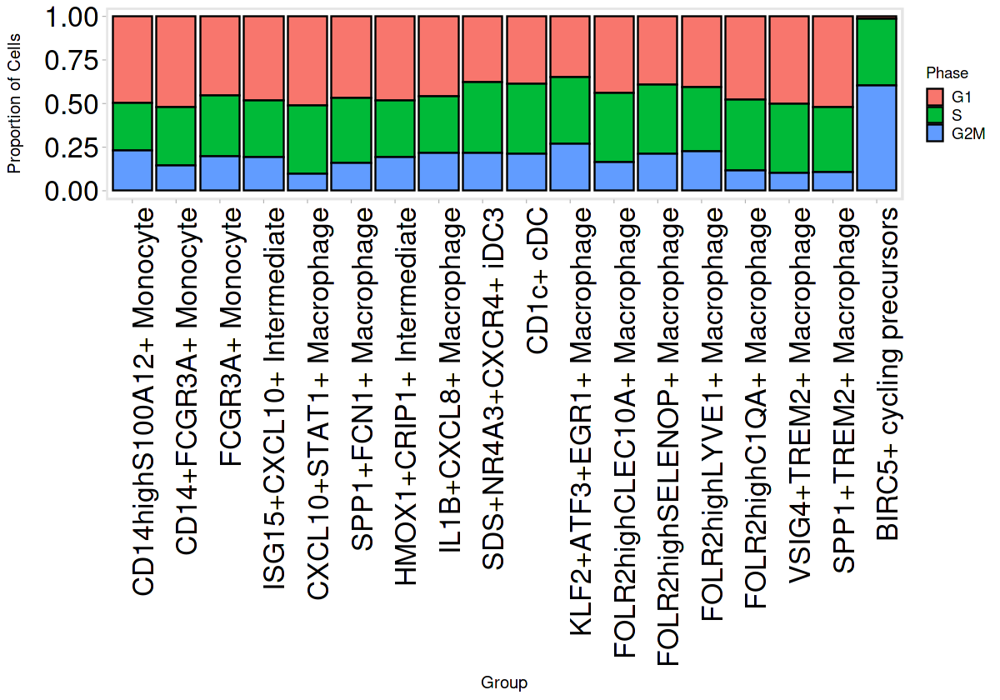

In [43]:
options(repr.plot.width=10, repr.plot.height=7)
freq_table_phase <- as.data.frame(prop.table(x = table(cyling.myeloid@meta.data[, "Phase"], cyling.myeloid@meta.data[, "clusters"]), margin = 2))
ggplot(data=freq_table_phase, aes(x=freq_table_phase$Var2, y=freq_table_phase$Freq, fill=freq_table_phase$Var1)) + theme_powerpoint() +
  geom_bar(stat="identity", color="black") + labs(x="Group", y="Proportion of Cells", fill="Phase") + theme(strip.text = element_text(size = 15, face="bold"), strip.background = element_rect(), axis.text=element_text(size=20), axis.text.x=element_text(angle=90, hjust=1)) 

In [ ]:
cyling.myeloid <- ScaleData(cyling.myeloid, vars.to.regress = c("S.Score", "G2M.Score"), features = rownames(cyling.myeloid)) %>% RunPCA()

Regressing out S.Score, G2M.Score



In [ ]:
#Harmonize
cyling.myeloid <- cyling.myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,1))

In [130]:
#Run UMAP and clustering
cyling.myeloid <- RunUMAP(object = cyling.myeloid, reduction = "harmony", dims = 1:40)

22:32:57 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

22:32:57 Read 80580 rows and found 40 numeric columns

22:32:57 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

22:32:57 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

22:33:09 Writing NN index file to temp file /datastore/lucy/tmp//file19b24b3bdd15a4

22:33:09 Searching Annoy index using 1 thread, search_k = 3000

22:33:58 Annoy recall = 100%

22:34:00 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

22:34:05 Initializing from normalized Lapla

In [ ]:
saveRDS(cyling.myeloid, "cycling.myeloid.rds")

In [40]:
cyling.myeloid <- readRDS("cycling.myeloid.rds")

In [60]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(cyling.myeloid@meta.data),Embeddings(cyling.myeloid, reduction = "umap")[,1], Embeddings(cyling.myeloid, reduction = "umap")[,2],
                   cyling.myeloid$Tissue,cyling.myeloid$group,cyling.myeloid$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
umap$color_col <- as.ordered(factor(umap$color_col, levels=levels(cyling.myeloid$clusters)))
levels(umap$color_col)
umap <- umap[order(umap$ID),]

[1] "CD14highS100A12+ Monocyte"    "CD14+FCGR3A+ Monocyte"       
 [3] "FCGR3A+ Monocyte"             "ISG15+CXCL10+ Intermediate"  
 [5] "CXCL10+STAT1+ Macrophage"     "SPP1+FCN1+ Macrophage"       
 [7] "HMOX1+CRIP1+ Intermediate"    "IL1B+CXCL8+ Macrophage"      
 [9] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[11] "KLF2+ATF3+EGR1+ Macrophage"   "FOLR2highCLEC10A+ Macrophage"
[13] "FOLR2highSELENOP+ Macrophage" "FOLR2highLYVE1+ Macrophage"  
[15] "FOLR2highC1QA+ Macrophage"    "VSIG4+TREM2+ Macrophage"     
[17] "SPP1+TREM2+ Macrophage"       "BIRC5+ cycling precursors"

In [61]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15)) + theme(strip.background = element_rect(colour = "black", fill = "white"),strip.text = element_text(size = 20, color="black"))

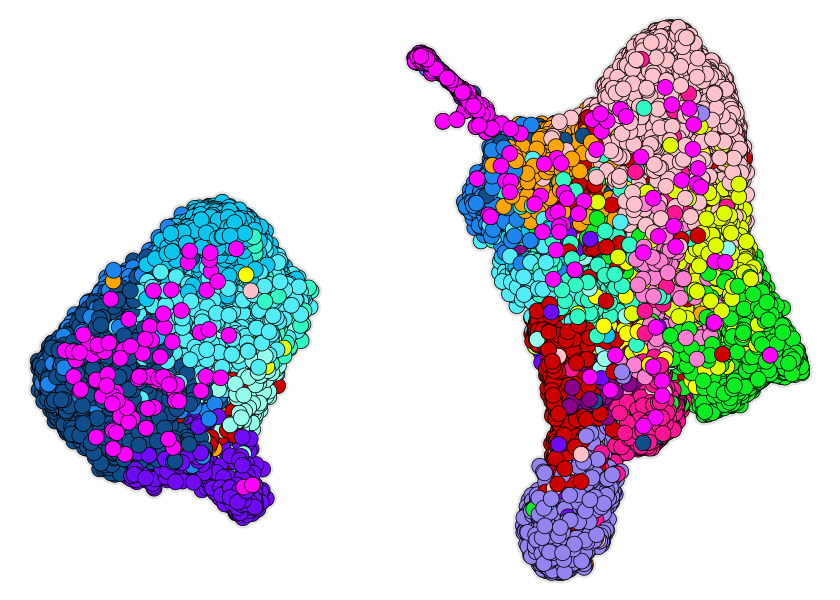

In [62]:
Idents(cyling.myeloid) <- "clusters"
BIRC5.cells <- WhichCells(cyling.myeloid, ident=c("BIRC5+ cycling precursors"))
BIRC5 <- umap[which(umap$ID%in%BIRC5.cells),]

options(repr.plot.width=7, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=umap, colour="grey89", fill="grey89", size=5, shape=21) + 
  geom_point(aes(fill=factor(color_col)),color="black", size=4, shape=21, stroke = 1/4) + 
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) +
  geom_point(data=BIRC5, fill="magenta",color="black", size=4, shape=21, stroke=1/4) + theme_void() + guides(fill=FALSE, color=FALSE) 


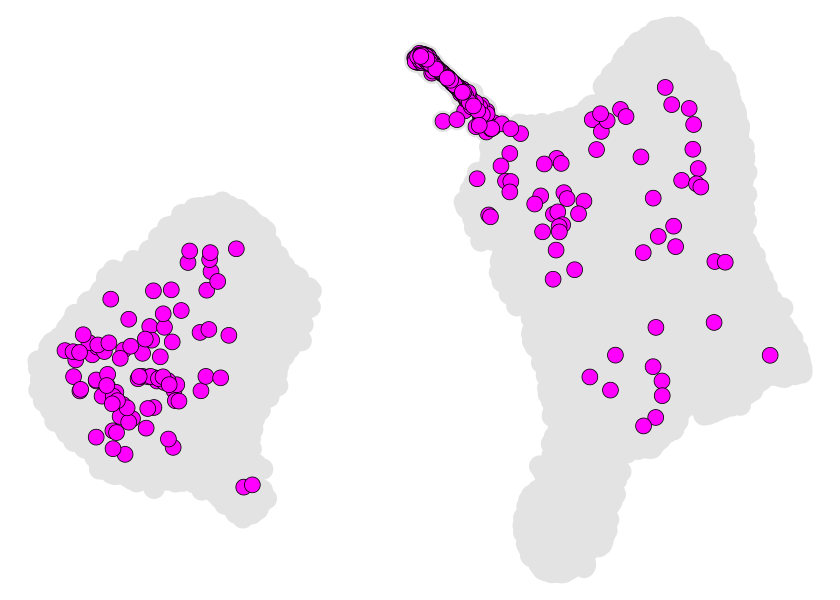

In [63]:
Idents(cyling.myeloid) <- "clusters"
BIRC5.cells <- WhichCells(cyling.myeloid, ident=c("BIRC5+ cycling precursors"))
BIRC5 <- umap[which(umap$ID%in%BIRC5.cells),]

ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=umap, colour="grey89", fill="grey89", size=5, shape=21) + 
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) +
  geom_point(data=BIRC5, fill="magenta",color="black", size=4, shape=21, stroke=1/4) + theme_void() + guides(fill=FALSE, color=FALSE) 


# Progeny

In [20]:
## We create a data frame with the specification of the cells that belong to 
## each cluster to match with the Progeny scores.
CellsClusters <- data.frame(Cell = names(Idents(myeloid)), 
    CellType = as.character(Idents(myeloid)),
    stringsAsFactors = FALSE)

In [21]:
library(progeny)
library(ggplot2)
library(dplyr)
library(tidyr)
library(tibble)

## We compute the Progeny activity scores and add them to our Seurat object
## as a new assay called Progeny. 
myeloid <- progeny(myeloid, scale=FALSE, organism="Human", top=500, perm=1, 
    return_assay = TRUE)

## We can now directly apply Seurat functions in our Progeny scores. 
## For instance, we scale the pathway activity scores. 
myeloid <- Seurat::ScaleData(myeloid, assay = "progeny") 

## We transform Progeny scores into a data frame to better handling the results
progeny_scores_df <- 
    as.data.frame(t(GetAssayData(myeloid, slot = "scale.data", 
        assay = "progeny"))) %>%
    rownames_to_column("Cell") %>%
    gather(Pathway, Activity, -Cell) 

## We match Progeny scores with the cell clusters.
progeny_scores_df <- inner_join(progeny_scores_df, CellsClusters)

## We summarize the Progeny scores by cellpopulation
summarized_progeny_scores <- progeny_scores_df %>% 
    group_by(Pathway, CellType) %>%
    summarise(avg = mean(Activity), std = sd(Activity))

Centering and scaling data matrix

Joining with `by = join_by(Cell)`
`summarise()` has grouped output by 'Pathway'. You can override using the `.groups` argument.


In [22]:
## We prepare the data for the plot
summarized_progeny_scores_df <- summarized_progeny_scores %>%
    dplyr::select(-std) %>%   
    spread(Pathway, avg) %>%
    data.frame(row.names = 1, check.names = FALSE, stringsAsFactors = FALSE) 

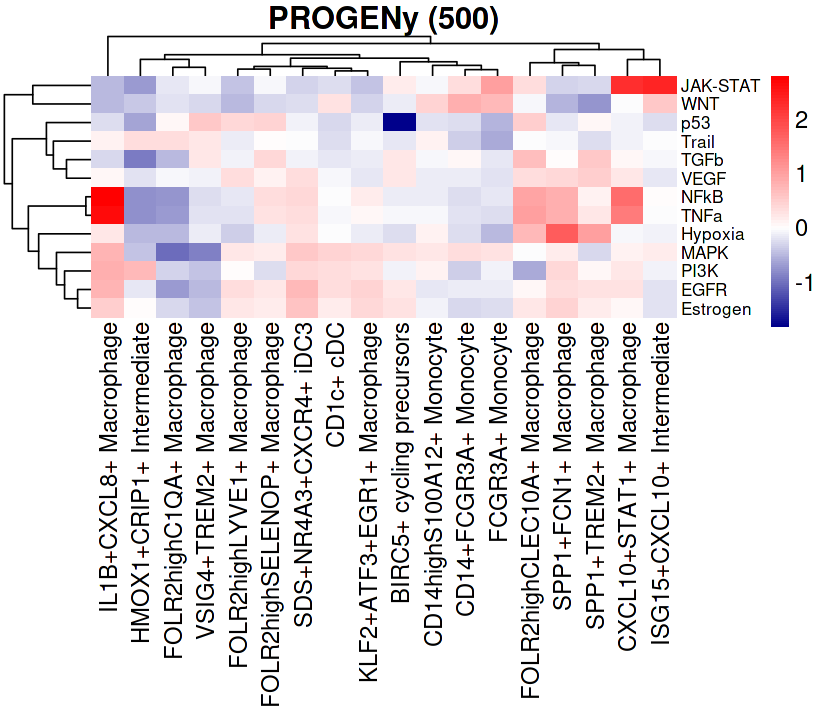

In [29]:
paletteLength = 100
myColor = colorRampPalette(c("Darkblue", "white","red"))(paletteLength)
options(repr.plot.width=7, repr.plot.height=6)
progenyBreaks = c(seq(min(summarized_progeny_scores_df), 0, 
                      length.out=ceiling(paletteLength/2) + 1),
                  seq(max(summarized_progeny_scores_df)/paletteLength, 
                      max(summarized_progeny_scores_df), 
                      length.out=floor(paletteLength/2)))
progeny_hmap = pheatmap(t(summarized_progeny_scores_df[,-1]),fontsize=14, 
                        fontsize_row = 10, 
                        color=myColor, breaks = progenyBreaks, 
                        main = "PROGENy (500)", angle_col = 90,
                        treeheight_col = 20,  border_color = NA, cluster_cols=TRUE)